In [ ]:
import os
from google.colab import files

files.upload()
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

Saving kaggle (1).json to kaggle (1).json
cp: cannot stat 'kaggle.json': No such file or directory
chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory


In [ ]:
# Download the dataset using Kaggle CLI
!kaggle datasets download -d amreen8441/annotated-driver-drowsiness
# Unzip the downloaded dataset
!unzip annotated-driver-drowsiness -d ./dataset

Streaming output truncated to the last 5000 lines.
  inflating: ./dataset/train/labels/209_jpg.rf.31612d8c3b9610a29aa709951060e77a.txt  
  inflating: ./dataset/train/labels/209_jpg.rf.554c7959850fc6bd8de435e9e804052e.txt  
  inflating: ./dataset/train/labels/209_jpg.rf.7f55402ecb1d8c84049dc4d4ee3a0fdb.txt  
  inflating: ./dataset/train/labels/209_jpg.rf.a3bbfc3618e1f4dd72002358b5570319.txt  
  inflating: ./dataset/train/labels/209_jpg.rf.f99e179d7a58a4cbc06b39442c40dd5f.txt  
  inflating: ./dataset/train/labels/20_jpg.rf.22c29ad6a2d170f2edc4eaf0a56ce044.txt  
  inflating: ./dataset/train/labels/20_jpg.rf.22c2e2229e2d479b778c8fda5c208e8b.txt  
  inflating: ./dataset/train/labels/20_jpg.rf.ad210c5b47051f56c0b7308b8e281e8c.txt  
  inflating: ./dataset/train/labels/2110_jpg.rf.ab9764c9f58f2d1d383c1cad058323b4.txt  
  inflating: ./dataset/train/labels/2110_jpg.rf.b6a6cfc67a6423c9729a4a6f5151d0a2.txt  
  inflating: ./dataset/train/labels/2110_jpg.rf.fd3b7ebb9b2e49b20c6fadcb3b0bfbc5.txt  
  i

In [ ]:
import os

# Define dataset path
dataset_path = "/content/dataset"

# Splits (train, valid, test)
splits = ["train", "valid", "test"]

# Dictionary to store counts
category_counts = {}

# Loop through each split
for split in splits:
    split_path = os.path.join(dataset_path, split)
    if os.path.exists(split_path):
        print(f"\n--- {split.upper()} SET ---")
        for category in os.listdir(split_path):
            category_path = os.path.join(split_path, category)
            if os.path.isdir(category_path):
                num_images = len(os.listdir(category_path))
                category_counts.setdefault(category, {})[split] = num_images
                print(f"Category: {category}, Images: {num_images}")

# Summary
print("\n--- SUMMARY ---")
for category, counts in category_counts.items():
    print(f"Category: {category}")
    for split, count in counts.items():
        print(f"  {split}: {count} images")


--- TRAIN SET ---
Category: images, Images: 4005
Category: labels, Images: 4005

--- VALID SET ---
Category: images, Images: 783
Category: labels, Images: 783

--- TEST SET ---
Category: images, Images: 782
Category: labels, Images: 782

--- SUMMARY ---
Category: images
  train: 4005 images
  valid: 783 images
  test: 782 images
Category: labels
  train: 4005 images
  valid: 783 images
  test: 782 images


In [ ]:
import os

label_dir = "dataset/train/labels"
categories = {"0": "drowsy", "1": "not_drowsy"}

for file in os.listdir(label_dir):
    with open(os.path.join(label_dir, file), "r") as f:
        lines = f.readlines()
        for line in lines:
            class_id = line.split()[0]  # Get the first value (class ID)
            print(f"{file}: {categories[class_id]}")

_627_jpg.rf.49e8625d3c5f2fbbf06ea5dd95fe67aa.txt: drowsy
_107_jpg.rf.f040734ca0105149efa3f492e52b709d.txt: not_drowsy
_640_jpg.rf.180637288166006277032abb2cc89a63.txt: not_drowsy
1931_jpg.rf.1e8196a7e4cb7e28e28a6b2d8b1479af.txt: not_drowsy
_182_jpg.rf.18a90a5669f00da0ddafde39a2d4efcf.txt: not_drowsy
2496_jpg.rf.fbf08e43a32bbf24db57a7eb1224e479.txt: not_drowsy
_381_jpg.rf.cf0967c696b279308ffcbcecea94f716.txt: not_drowsy
199_jpg.rf.fa318359bb7bd9bcaeb9314a8829738c.txt: drowsy
604_jpg.rf.e7b974e7fa637060c58bbf1623333a70.txt: drowsy
324_jpg.rf.bf19ab50d4233e5463ca43de7dff24fa.txt: drowsy
_534_jpg.rf.d115246763c286048289047c498f9a33.txt: drowsy
_531_jpg.rf.f3f41c2e598d045da049b759215cdd85.txt: not_drowsy
_379_jpg.rf.3e39bff46ec5aaa14db90d2b57fd6805.txt: drowsy
142_jpg.rf.93b908fba4b3d4a4bdd03d3778c71f5a.txt: not_drowsy
_197_jpg.rf.d316b3b6390f569111837ebb7a2d1a40.txt: not_drowsy
209_jpg.rf.31612d8c3b9610a29aa709951060e77a.txt: not_drowsy
_186_jpg.rf.e65e21e175c3ac713900b4bea907a6cd.txt: dro

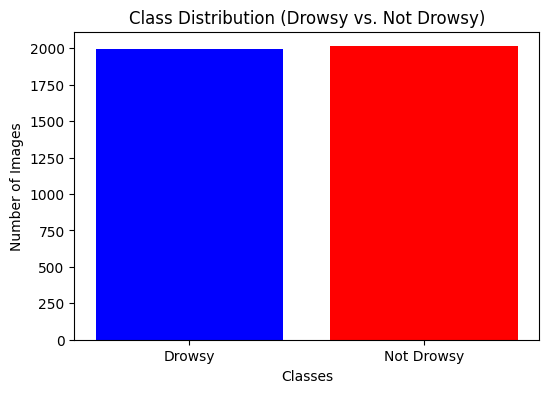

Class Distribution: {'Drowsy': 1995, 'Not Drowsy': 2013}


In [ ]:
#Class Balance
import os
import matplotlib.pyplot as plt

# Define paths
image_dir = "dataset/train/images"  # Path where images are stored
label_dir = "dataset/train/labels"  # Path where label text files are stored

# Define class categories
categories = {"0": "Drowsy", "1": "Not Drowsy"}
class_counts = {"Drowsy": 0, "Not Drowsy": 0}

# Get image file names (without extensions)
image_files = {os.path.splitext(file)[0] for file in os.listdir(image_dir)}

# Read label files
for label_file in os.listdir(label_dir):
    base_name = os.path.splitext(label_file)[0]  # Remove .txt extension
    if base_name in image_files:  # Ensure label file has a corresponding image
        with open(os.path.join(label_dir, label_file), "r") as f:
            lines = f.readlines()
            for line in lines:
                class_id = line.split()[0]  # Get first value (class ID)
                class_counts[categories[class_id]] += 1

# Plot class distribution
plt.figure(figsize=(6, 4))
plt.bar(class_counts.keys(), class_counts.values(), color=['blue', 'red'])
plt.xlabel("Classes")
plt.ylabel("Number of Images")
plt.title("Class Distribution (Drowsy vs. Not Drowsy)")
plt.show()

# Print counts
print("Class Distribution:", class_counts)

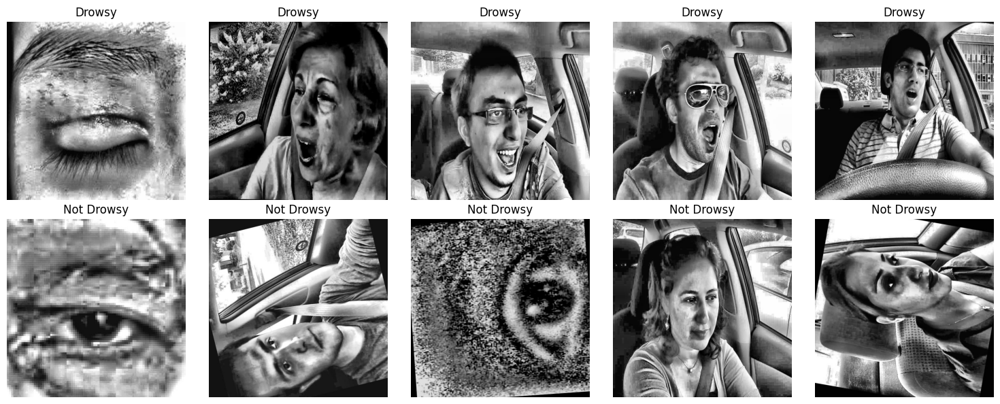

In [ ]:
#Class label visualization
import random
import os
import cv2
import matplotlib.pyplot as plt

# Define dataset path
image_dir = "/content/dataset/train/images"
label_dir = "/content/dataset/train/labels"

# Define class labels
image_classes = {"0": "Drowsy", "1": "Not Drowsy"}

# Dictionary to store images for each class
class_images = {"0": [], "1": []}

# Read label files and map them to images
for label_file in os.listdir(label_dir):
    if label_file.endswith(".txt"):  # Ensure it's a label file
        label_path = os.path.join(label_dir, label_file)
        with open(label_path, "r") as f:
            lines = f.readlines()
            for line in lines:
                class_id = line.split()[0]  # First value in YOLO format = class ID
                image_file = label_file.replace(".txt", ".jpg")  # Change extension to .jpg
                image_path = os.path.join(image_dir, image_file)

                if os.path.exists(image_path):  # Ensure image exists
                    class_images[class_id].append(image_path)

# Create subplots
fig, axes = plt.subplots(2, 5, figsize=(15, 6))

for i, (cls, label) in enumerate(image_classes.items()):
    images = class_images.get(cls, [])

    if len(images) < 5:
        print(f" Not enough images for class '{label}' ({len(images)} found). Skipping...")
        continue

    for j in range(5):
        try:
            img_path = random.choice(images)  # Select random image
            img = cv2.imread(img_path)

            if img is None:
                print(f"Skipping unreadable image: {img_path}")
                continue

            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            axes[i, j].imshow(img)
            axes[i, j].axis("off")
            axes[i, j].set_title(label)

        except Exception as e:
            print(f"Error loading image {img_path}: {e}")

plt.tight_layout()
plt.show()

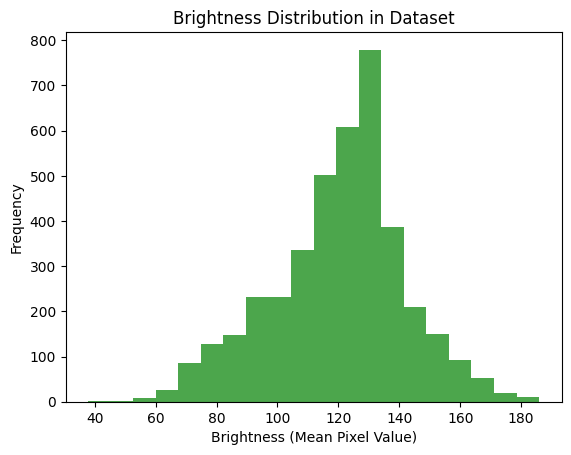

In [ ]:
#Brightness check
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt

# Define dataset path
image_dir = "dataset/train/images"

def brightness(image_path):
    img = cv2.imread(image_path)
    if img is None:
        return None  # Skip unreadable files
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    return np.mean(hsv[:, :, 2])  # 'V' (Value) channel represents brightness

brightness_values = []

# Loop through images and check brightness
for img_name in os.listdir(image_dir):
    img_path = os.path.join(image_dir, img_name)

    if img_name.lower().endswith(('.png', '.jpg', '.jpeg')):  # Ensure it's an image
        value = brightness(img_path)
        if value is not None:
            brightness_values.append(value)

# Plot brightness distribution
plt.hist(brightness_values, bins=20, color='green', alpha=0.7)
plt.xlabel("Brightness (Mean Pixel Value)")
plt.ylabel("Frequency")
plt.title("Brightness Distribution in Dataset")
plt.show()

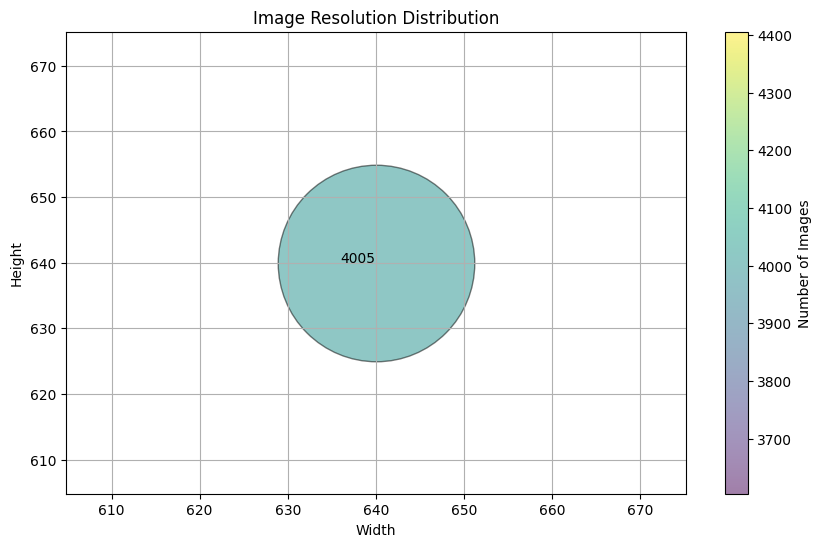

In [ ]:
#Image resolution check
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from collections import Counter

# Store image resolutions
image_shapes = []

# Read images and extract resolutions
for img_name in os.listdir(image_dir):
    img_path = os.path.join(image_dir, img_name)
    img = cv2.imread(img_path)

    if img is not None:
        shape = img.shape[:2]  # (height, width)
        image_shapes.append(shape)

# Convert to numpy array
image_shapes = np.array(image_shapes)

# Count occurrences of each resolution
resolution_counts = Counter(map(tuple, image_shapes))

# Sort resolutions by frequency
sorted_resolutions = sorted(resolution_counts.items(), key=lambda x: x[1], reverse=True)

# Extract width, height, and counts
widths = [res[1] for res, count in sorted_resolutions]
heights = [res[0] for res, count in sorted_resolutions]
counts = [count for res, count in sorted_resolutions]

# Scatter plot with bubble sizes representing frequency
plt.figure(figsize=(10, 6))
plt.scatter(widths, heights, s=np.array(counts) * 5, alpha=0.5, c=counts, cmap="viridis", edgecolors="black")
plt.colorbar(label="Number of Images")
plt.xlabel("Width")
plt.ylabel("Height")
plt.title("Image Resolution Distribution")
plt.grid(True)

# Annotate most common resolutions
for (w, h), count in sorted_resolutions[:5]:  # Top 5 common resolutions
    plt.annotate(f"{count}", (w, h), fontsize=10, color="black", ha="right")

plt.show()

In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 932.9/932.9 kB 28.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 116.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 84.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 57.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 14.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 93.0 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstal

In [ ]:
with open("/content/dataset/data.yaml", "r") as f:
    print(f.read())

train: ../train/images
val: ../valid/images
test: ../test/images

nc: 2
names: ['drowsy', 'not_drowsy']

roboflow:
  workspace: driver-no-yawn
  project: driver-drowsiness1
  version: 3
  license: CC BY 4.0
  url: https://universe.roboflow.com/driver-no-yawn/driver-drowsiness1/dataset/3


YOLO11n

In [ ]:
from ultralytics import YOLO

#Load YOLOv11n model
model = YOLO("yolo11n.pt")  # Load YOLOv11n pretrained model

# Function to extract accuracy from validation results
def extract_accuracy(val_results):
    return val_results.box.map50.mean()  # Use mAP@50 as an approximation for accuracy

# Train the model and display live Accuracy & Loss
for epoch in range(10):  # Run for 10 epochs
    print(f"\n Training Epoch {epoch+1}/10...")

    # Run training for one epoch
    model.train(
        data="/content/dataset/data.yaml",  # Dataset path
        epochs=1,  # Train one epoch at a time to display metrics
        batch=16,  # Batch size optimized for T4 GPU
        imgsz=640,  # Image size
        device="cuda",  # Run on T4 GPU
        optimizer="AdamW",  # Optimized optimizer
        lr0=0.001,  # Learning rate
        patience=3,  # Early stopping
        augment=True,  # Data augmentation
        cos_lr=True,  # Cosine LR scheduler
        weight_decay=1e-4,  # Prevent overfitting
        val=True,  # Enable validation
        workers=4,  # Number of CPU workers
        verbose=True,  # Show training progress
    )
    # Extract loss from the last logged training epoch
    log_file = "runs/detect/train/results.csv"  # YOLO training logs
    try:
        with open(log_file, "r") as f:
            lines = f.readlines()
            last_log = lines[-1].strip().split(",")  # Get last epoch data
            loss = float(last_log[2])  # Box loss (as an example)
    except Exception as e:
        print(f" Warning: Could not extract loss from logs. Error: {e}")
        loss = -1  # Default value if log reading fails

    #  Run validation after each epoch
    val_results = model.val(data="/content/dataset/data.yaml", split="val")
    # Compute and display Accuracy & Loss
    accuracy = extract_accuracy(val_results)
    print(f" **Epoch {epoch+1} Metrics:**")
    print(f" Accuracy: {accuracy:.4f}")
    print(f" Loss: {loss:.4f}")
# Save the trained model
model.export(format="torchscript")  # Save for efficient inference


🚀 Training Epoch 1/10...
New https://pypi.org/project/ultralytics/8.3.85 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=3, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=4, project=None, name=train8, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, s

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/train8/labels.jpg... 
optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0001), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train8
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      2.31G      1.456      2.046      1.783          5        640: 100%|██████████| 251/251 [01:23<00:00,  3.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09<00:00,  2.51it/s]


                   all        783        784      0.689      0.774      0.747      0.352

1 epochs completed in 0.028 hours.
Optimizer stripped from runs/detect/train8/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/train8/weights/best.pt, 5.5MB

Validating runs/detect/train8/weights/best.pt...
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:11<00:00,  2.12it/s]


                   all        783        784      0.711       0.82      0.796      0.394
                drowsy        381        381      0.649      0.887      0.747       0.36
            not_drowsy        402        403      0.773      0.752      0.846      0.427
Speed: 0.2ms preprocess, 7.4ms inference, 0.0ms loss, 1.7ms postprocess per image
Results saved to runs/detect/train8
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:12<00:00,  3.90it/s]


                   all        783        784      0.701      0.833      0.797      0.395
                drowsy        381        381      0.637      0.898      0.746       0.36
            not_drowsy        402        403      0.764      0.769      0.847      0.429
Speed: 0.7ms preprocess, 9.3ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to runs/detect/train82
📊 **Epoch 1 Metrics:**
✅ Accuracy: 0.7966
✅ Loss: 1.4565

🚀 Training Epoch 2/10...
New https://pypi.org/project/ultralytics/8.3.85 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=3, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=4, project=None, name=train83, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, 

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/train83/labels.jpg... 
optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0001), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train83
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      2.34G      1.642      1.763      1.911          5        640: 100%|██████████| 251/251 [01:23<00:00,  3.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:10<00:00,  2.48it/s]


                   all        783        784      0.753      0.742      0.828      0.386

1 epochs completed in 0.029 hours.
Optimizer stripped from runs/detect/train83/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/train83/weights/best.pt, 5.5MB

Validating runs/detect/train83/weights/best.pt...
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:11<00:00,  2.11it/s]


                   all        783        784      0.776      0.748      0.825      0.399
                drowsy        381        381      0.662      0.874      0.826      0.406
            not_drowsy        402        403       0.89      0.622      0.824      0.393
Speed: 0.2ms preprocess, 7.5ms inference, 0.0ms loss, 1.7ms postprocess per image
Results saved to runs/detect/train83
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:12<00:00,  4.01it/s]


                   all        783        784      0.775      0.741      0.824      0.398
                drowsy        381        381       0.66      0.866      0.825      0.405
            not_drowsy        402        403       0.89      0.615      0.823      0.392
Speed: 0.8ms preprocess, 9.4ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to runs/detect/train832
📊 **Epoch 2 Metrics:**
✅ Accuracy: 0.8240
✅ Loss: 1.4565

🚀 Training Epoch 3/10...
New https://pypi.org/project/ultralytics/8.3.85 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=3, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=4, project=None, name=train833, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/train833/labels.jpg... 
optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0001), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train833
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      2.32G      1.453       1.52      1.758          5        640: 100%|██████████| 251/251 [01:23<00:00,  3.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:10<00:00,  2.47it/s]


                   all        783        784       0.85       0.82      0.893      0.414

1 epochs completed in 0.029 hours.
Optimizer stripped from runs/detect/train833/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/train833/weights/best.pt, 5.5MB

Validating runs/detect/train833/weights/best.pt...
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:11<00:00,  2.10it/s]


                   all        783        784      0.814      0.871      0.907      0.439
                drowsy        381        381      0.778      0.837      0.885      0.404
            not_drowsy        402        403      0.851      0.906       0.93      0.474
Speed: 0.2ms preprocess, 7.4ms inference, 0.0ms loss, 1.8ms postprocess per image
Results saved to runs/detect/train833
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:12<00:00,  4.02it/s]


                   all        783        784      0.812      0.878      0.907      0.438
                drowsy        381        381      0.772      0.846      0.884      0.403
            not_drowsy        402        403      0.851      0.909       0.93      0.473
Speed: 0.7ms preprocess, 9.4ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to runs/detect/train8332
📊 **Epoch 3 Metrics:**
✅ Accuracy: 0.9071
✅ Loss: 1.4565

🚀 Training Epoch 4/10...
New https://pypi.org/project/ultralytics/8.3.85 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=3, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=4, project=None, name=train8333, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=Fal

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/train8333/labels.jpg... 
optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0001), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train8333
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      2.31G      1.386      1.402      1.697          5        640: 100%|██████████| 251/251 [01:22<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09<00:00,  2.50it/s]


                   all        783        784       0.85      0.884      0.925      0.493

1 epochs completed in 0.028 hours.
Optimizer stripped from runs/detect/train8333/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/train8333/weights/best.pt, 5.5MB

Validating runs/detect/train8333/weights/best.pt...
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:11<00:00,  2.11it/s]


                   all        783        784      0.894      0.901      0.948      0.495
                drowsy        381        381      0.877      0.936      0.962      0.513
            not_drowsy        402        403      0.911      0.866      0.934      0.478
Speed: 0.3ms preprocess, 7.6ms inference, 0.0ms loss, 1.8ms postprocess per image
Results saved to runs/detect/train8333
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:12<00:00,  4.05it/s]


                   all        783        784      0.894      0.899       0.95      0.497
                drowsy        381        381      0.879      0.934      0.965      0.515
            not_drowsy        402        403       0.91      0.864      0.934      0.478
Speed: 0.9ms preprocess, 9.3ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to runs/detect/train83332
📊 **Epoch 4 Metrics:**
✅ Accuracy: 0.9497
✅ Loss: 1.4565

🚀 Training Epoch 5/10...
New https://pypi.org/project/ultralytics/8.3.85 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=3, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=4, project=None, name=train83333, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=F

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/train83333/labels.jpg... 
optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0001), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train83333
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      2.34G      1.333      1.338      1.656          5        640: 100%|██████████| 251/251 [01:22<00:00,  3.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:10<00:00,  2.47it/s]


                   all        783        784      0.784      0.662      0.755      0.348

1 epochs completed in 0.028 hours.
Optimizer stripped from runs/detect/train83333/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/train83333/weights/best.pt, 5.5MB

Validating runs/detect/train83333/weights/best.pt...
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:11<00:00,  2.10it/s]


                   all        783        784      0.834      0.755      0.848      0.422
                drowsy        381        381       0.81      0.769      0.852      0.419
            not_drowsy        402        403      0.857      0.742      0.844      0.426
Speed: 0.2ms preprocess, 7.5ms inference, 0.0ms loss, 1.6ms postprocess per image
Results saved to runs/detect/train83333
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:11<00:00,  4.08it/s]


                   all        783        784      0.836      0.757       0.85      0.424
                drowsy        381        381       0.81      0.773      0.853       0.42
            not_drowsy        402        403      0.861      0.742      0.846      0.428
Speed: 0.7ms preprocess, 9.3ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to runs/detect/train833332
📊 **Epoch 5 Metrics:**
✅ Accuracy: 0.8495
✅ Loss: 1.4565

🚀 Training Epoch 6/10...
New https://pypi.org/project/ultralytics/8.3.85 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=3, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=4, project=None, name=train833333, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/train833333/labels.jpg... 
optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0001), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train833333
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      2.32G      1.293      1.264      1.621          5        640: 100%|██████████| 251/251 [01:26<00:00,  2.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09<00:00,  2.53it/s]


                   all        783        784      0.929      0.894      0.947      0.512

1 epochs completed in 0.029 hours.
Optimizer stripped from runs/detect/train833333/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/train833333/weights/best.pt, 5.5MB

Validating runs/detect/train833333/weights/best.pt...
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:12<00:00,  1.95it/s]


                   all        783        784      0.916      0.924       0.96      0.515
                drowsy        381        381      0.892      0.948      0.972      0.544
            not_drowsy        402        403       0.94      0.901      0.947      0.487
Speed: 0.3ms preprocess, 7.6ms inference, 0.0ms loss, 2.2ms postprocess per image
Results saved to runs/detect/train833333
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:12<00:00,  4.01it/s]


                   all        783        784      0.917      0.924      0.961      0.516
                drowsy        381        381      0.894      0.948      0.972      0.544
            not_drowsy        402        403       0.94      0.901       0.95      0.488
Speed: 0.6ms preprocess, 9.6ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to runs/detect/train8333332
📊 **Epoch 6 Metrics:**
✅ Accuracy: 0.9608
✅ Loss: 1.4565

🚀 Training Epoch 7/10...
New https://pypi.org/project/ultralytics/8.3.85 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=3, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=4, project=None, name=train8333333, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_c

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/train8333333/labels.jpg... 
optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0001), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train8333333
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      2.35G      1.243      1.204      1.581          5        640: 100%|██████████| 251/251 [01:25<00:00,  2.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:10<00:00,  2.43it/s]


                   all        783        784      0.936       0.91      0.951      0.509

1 epochs completed in 0.030 hours.
Optimizer stripped from runs/detect/train8333333/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/train8333333/weights/best.pt, 5.5MB

Validating runs/detect/train8333333/weights/best.pt...
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:11<00:00,  2.16it/s]


                   all        783        784      0.935      0.899      0.952      0.507
                drowsy        381        381      0.944      0.927       0.97      0.527
            not_drowsy        402        403      0.926      0.871      0.934      0.486
Speed: 0.2ms preprocess, 7.5ms inference, 0.0ms loss, 1.7ms postprocess per image
Results saved to runs/detect/train8333333
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:12<00:00,  3.93it/s]


                   all        783        784      0.934      0.902      0.952      0.505
                drowsy        381        381       0.94      0.932       0.97      0.526
            not_drowsy        402        403      0.929      0.873      0.934      0.484
Speed: 1.0ms preprocess, 9.4ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to runs/detect/train83333332
📊 **Epoch 7 Metrics:**
✅ Accuracy: 0.9521
✅ Loss: 1.4565

🚀 Training Epoch 8/10...
New https://pypi.org/project/ultralytics/8.3.85 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=3, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=4, project=None, name=train83333333, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/train83333333/labels.jpg... 
optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0001), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train83333333
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      2.35G      1.213      1.162      1.558          5        640: 100%|██████████| 251/251 [01:24<00:00,  2.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:10<00:00,  2.39it/s]


                   all        783        784      0.894      0.884      0.929      0.474

1 epochs completed in 0.029 hours.
Optimizer stripped from runs/detect/train83333333/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/train83333333/weights/best.pt, 5.5MB

Validating runs/detect/train83333333/weights/best.pt...
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:11<00:00,  2.09it/s]


                   all        783        784      0.893      0.915      0.946        0.5
                drowsy        381        381      0.875      0.938      0.954      0.509
            not_drowsy        402        403      0.911      0.892      0.938      0.491
Speed: 0.3ms preprocess, 7.7ms inference, 0.0ms loss, 1.7ms postprocess per image
Results saved to runs/detect/train83333333
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:12<00:00,  3.97it/s]


                   all        783        784      0.892      0.914      0.945      0.499
                drowsy        381        381      0.875      0.938      0.954      0.509
            not_drowsy        402        403      0.909       0.89      0.935      0.489
Speed: 0.5ms preprocess, 9.8ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to runs/detect/train833333332
📊 **Epoch 8 Metrics:**
✅ Accuracy: 0.9446
✅ Loss: 1.4565

🚀 Training Epoch 9/10...
New https://pypi.org/project/ultralytics/8.3.85 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=3, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=4, project=None, name=train833333333, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, sing

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/train833333333/labels.jpg... 
optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0001), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train833333333
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      2.31G      1.195      1.138      1.541          5        640: 100%|██████████| 251/251 [01:23<00:00,  3.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:10<00:00,  2.39it/s]


                   all        783        784      0.923      0.895      0.931      0.465

1 epochs completed in 0.029 hours.
Optimizer stripped from runs/detect/train833333333/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/train833333333/weights/best.pt, 5.5MB

Validating runs/detect/train833333333/weights/best.pt...
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:11<00:00,  2.09it/s]


                   all        783        784      0.837      0.929       0.93      0.495
                drowsy        381        381      0.844      0.942      0.934      0.481
            not_drowsy        402        403       0.83      0.916      0.926      0.509
Speed: 0.2ms preprocess, 7.7ms inference, 0.0ms loss, 2.2ms postprocess per image
Results saved to runs/detect/train833333333
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:12<00:00,  3.99it/s]


                   all        783        784      0.838       0.93       0.93      0.494
                drowsy        381        381      0.844      0.942      0.934      0.481
            not_drowsy        402        403      0.831      0.918      0.926      0.508
Speed: 0.9ms preprocess, 9.4ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to runs/detect/train8333333332
📊 **Epoch 9 Metrics:**
✅ Accuracy: 0.9302
✅ Loss: 1.4565

🚀 Training Epoch 10/10...
New https://pypi.org/project/ultralytics/8.3.85 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=3, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=4, project=None, name=train8333333333, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, s

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/train8333333333/labels.jpg... 
optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0001), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train8333333333
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      2.31G      1.166      1.097      1.519          5        640: 100%|██████████| 251/251 [01:26<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09<00:00,  2.57it/s]


                   all        783        784      0.886      0.862      0.911      0.465

1 epochs completed in 0.029 hours.
Optimizer stripped from runs/detect/train8333333333/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/train8333333333/weights/best.pt, 5.5MB

Validating runs/detect/train8333333333/weights/best.pt...
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:11<00:00,  2.15it/s]


                   all        783        784      0.897      0.896      0.935      0.486
                drowsy        381        381      0.916      0.924      0.966      0.519
            not_drowsy        402        403      0.878      0.868      0.905      0.454
Speed: 0.2ms preprocess, 7.7ms inference, 0.0ms loss, 2.0ms postprocess per image
Results saved to runs/detect/train8333333333
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:12<00:00,  4.00it/s]


                   all        783        784      0.898      0.896      0.935      0.487
                drowsy        381        381      0.914      0.924      0.965      0.519
            not_drowsy        402        403      0.883      0.868      0.905      0.454
Speed: 0.8ms preprocess, 9.4ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to runs/detect/train83333333332
📊 **Epoch 10 Metrics:**
✅ Accuracy: 0.9349
✅ Loss: 1.4565
Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CPU (Intel Xeon 2.00GHz)

PyTorch: starting from 'runs/detect/train8333333333/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 6, 8400) (5.2 MB)

TorchScript: starting export with torch 2.5.1+cu124...
TorchScript: export success ✅ 3.5s, saved as 'runs/detect/train8333333333/weights/best.torchscript' (10.4 MB)

Export complete (5.3s)
Results saved to /content/runs/detect/train8333333333/weights
Predict:         yolo predict task=detect model=runs/detect/train

'runs/detect/train8333333333/weights/best.torchscript'

In [ ]:
from ultralytics import YOLO

# Load the trained model
model = YOLO("runs/detect/train8/weights/best.torchscript")

# Run validation
metrics = model.val(data="/content/dataset/data.yaml")

# Extract accuracy (mAP@50) - Access through box attribute
accuracy = metrics.box.map50  # Access map50 through the box attribute
print(f"**Final Accuracy (mAP@50): {accuracy:.4f}**")

Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
Loading runs/detect/train8/weights/best.torchscript for TorchScript inference...


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:09<00:00,  5.36it/s]


                   all        783        784      0.689      0.709      0.751      0.369
                drowsy        381        381      0.628      0.672       0.68      0.336
            not_drowsy        402        403       0.75      0.747      0.821      0.401
Speed: 0.7ms preprocess, 3.3ms inference, 0.0ms loss, 1.5ms postprocess per image
Results saved to runs/detect/val4
📊 **Final Accuracy (mAP@50): 0.7507**


In [ ]:
from ultralytics import YOLO

# Load the trained model
model = YOLO("runs/detect/train8/weights/best.pt")  # Update with correct path if needed

# Run validation on the test set
metrics = model.val(data="/content/dataset/data.yaml", split="test")

# Extract final accuracy (mAP@50)
# accuracy = metrics.results_dict["map50"]  # Incorrect: Assumes 'map50' is a direct key
accuracy = metrics.box.map50 # Correct: Access map50 through the box attribute
print(f"📊 **Final Test Accuracy (mAP@50): {accuracy:.4f}**")

Ultralytics 8.3.84 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,582,542 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/test/labels.cache... 782 images, 0 backgrounds, 0 corrupt: 100%|██████████| 782/782 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:10<00:00,  4.89it/s]


                   all        782        786      0.695      0.779      0.758      0.358
                drowsy        403        404      0.635       0.78      0.692      0.325
            not_drowsy        379        382      0.756      0.777      0.824      0.391
Speed: 0.7ms preprocess, 4.1ms inference, 0.0ms loss, 1.5ms postprocess per image
Results saved to runs/detect/val7
📊 **Final Test Accuracy (mAP@50): 0.7581**



0: 640x640 1 not_drowsy, 15.3ms
1: 640x640 2 not_drowsys, 15.3ms
2: 640x640 1 drowsy, 1 not_drowsy, 15.3ms
3: 640x640 3 drowsys, 15.3ms
4: 640x640 3 drowsys, 15.3ms
Speed: 3.7ms preprocess, 15.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


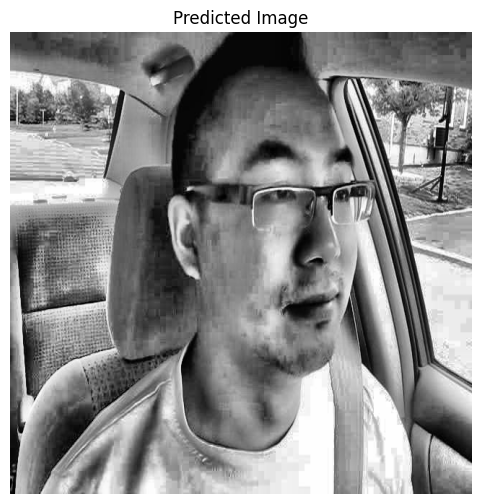

🔹 Class: not_drowsy, Confidence: 0.53


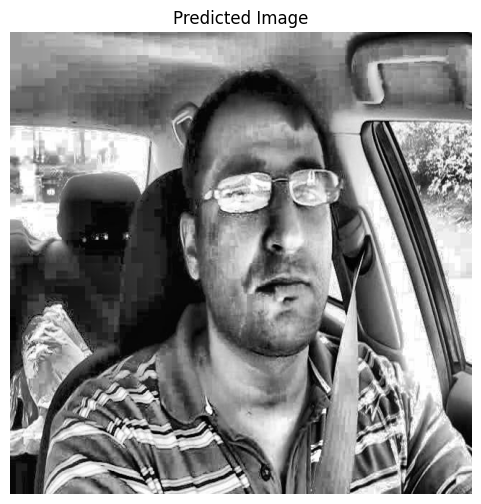

🔹 Class: not_drowsy, Confidence: 0.67
🔹 Class: not_drowsy, Confidence: 0.41


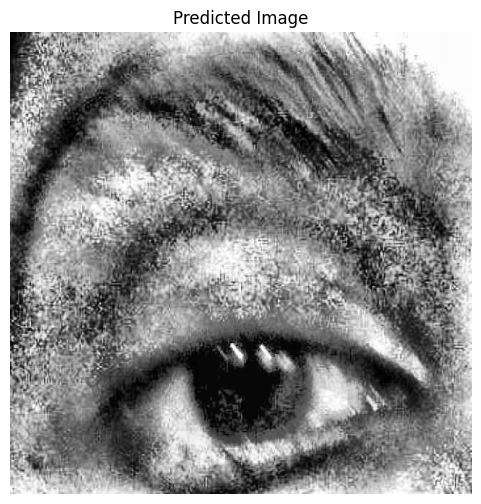

🔹 Class: drowsy, Confidence: 0.33
🔹 Class: not_drowsy, Confidence: 0.28


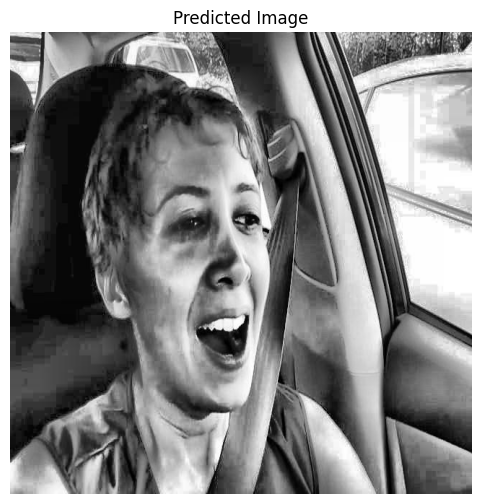

🔹 Class: drowsy, Confidence: 0.93
🔹 Class: drowsy, Confidence: 0.38
🔹 Class: drowsy, Confidence: 0.27


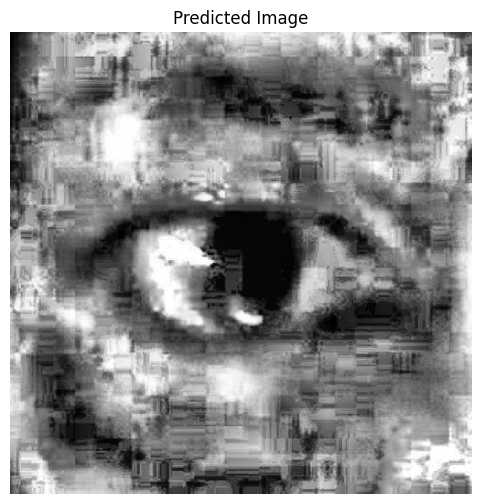

🔹 Class: drowsy, Confidence: 0.43
🔹 Class: drowsy, Confidence: 0.38
🔹 Class: drowsy, Confidence: 0.31
✅ Inference completed on 5 images!


In [ ]:
from ultralytics import YOLO
import glob
import cv2
import matplotlib.pyplot as plt

# Load the trained model
model = YOLO("runs/detect/train8/weights/best.pt")

#  Get 5 sample images from test dataset
image_paths = glob.glob("/content/dataset/test/images/*.jpg")[:5]

#  Run inference on the selected images
results = model(image_paths)  # Predict on images

# Display the images with predictions
for img_path, result in zip(image_paths, results):
    img = cv2.imread(img_path)  # Read image
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert to RGB

    plt.figure(figsize=(6,6))
    plt.imshow(img)
    plt.axis("off")  # Hide axes
    plt.title("Predicted Image")
    plt.show()

    #  Print detected objects & confidence scores
    for box in result.boxes.data:
        x1, y1, x2, y2, conf, cls = box.tolist()
        print(f"🔹 Class: {model.names[int(cls)]}, Confidence: {conf:.2f}")

print("Inference completed on 5 images!")

YOLO12n

In [ ]:
!git clone https://github.com/sunsmarterjie/yolov12.git
!cd yolov12

Cloning into 'yolov12'...
remote: Enumerating objects: 959, done.
remote: Counting objects: 100% (237/237), done.
remote: Compressing objects: 100% (57/57), done.
remote: Total 959 (delta 215), reused 181 (delta 180), pack-reused 722 (from 1)
Receiving objects: 100% (959/959), 1.59 MiB | 15.34 MiB/s, done.
Resolving deltas: 100% (457/457), done.


In [ ]:
import torch

# Empty cache to free GPU memory
torch.cuda.empty_cache()

# Forcibly delete all tensors in memory
import gc
gc.collect()

# Restart kernel (useful in Colab)
try:
    import IPython
    IPython.display.clear_output()
except:
    pass

print("GPU memory cleared successfully!")

✅ GPU memory cleared successfully!


In [ ]:
import torch
import gc

# Free GPU memory
torch.cuda.empty_cache()
torch.cuda.ipc_collect()

# Free CPU memory
gc.collect()

print("RAM & GPU memory freed successfully!")

✅ RAM & GPU memory freed successfully!


In [ ]:
from ultralytics import YOLO
import numpy as np

# Load YOLOv12 Model Configuration
model = YOLO("yolo12n.pt")  # Load YOLOv12 Nano pretrained model

# Training Settings
max_epochs = 20  # Train for 10-20 epochs
early_stop_threshold = 0.95  # Stop if all metrics reach 0.95

for epoch in range(max_epochs):
    # Train the model (one epoch at a time)
    results = model.train(
        data="/content/dataset/data.yaml",
        epochs=1,  # Train one epoch per loop
        batch=16,
        imgsz=640,

        # 🔹 Lower Learning Rate to Prevent Overfitting
        lr0=0.0008,  # Reduce LR
        cos_lr=True,
        warmup_epochs=3,
        warmup_bias_lr=0.01,

        # 🔹 Regularization to Avoid Overfitting
        weight_decay=0.0015,
        dropout=0.1,
        patience=5,  # Stop training if no improvement for 5 epochs

        # 🔹 Data Augmentation (Balanced)
        hsv_h=0.015,
        hsv_s=0.5,
        hsv_v=0.3,
        fliplr=0.5,
        translate=0.1,
        scale=0.3,
        mosaic=0.25,
        mixup=0.1,

        # 🔹 Optimization
        optimizer="AdamW",
        freeze=[5],  # Freeze backbone for better feature learning

        name="yolov12_tuned"
    )

    # Validate Model
    metrics = model.val()
    precision = np.mean(metrics.box.p)  # Precision
    recall = np.mean(metrics.box.r)  # Recall
    map50 = np.mean(metrics.box.map50)  # mAP50

    print(f"Epoch {epoch+1} - Precision: {precision:.4f}, Recall: {recall:.4f}, mAP50: {map50:.4f}")

    # Stop Training if All Metrics Reach 0.95
    if map50 >= early_stop_threshold and precision >= early_stop_threshold and recall >= early_stop_threshold:
        print(" Stopping early: Model has reached the performance threshold!")
        break

# Save the Model Weights in ONNX Format
model.export(format="onnx")  # ONNX format

Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo12n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=5, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov12_tuned, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=[5], multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.1, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_b

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov12_tuned/labels.jpg... 
optimizer: AdamW(lr=0.0008, momentum=0.937) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0015), 119 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/yolov12_tuned
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      5.67G      1.506      2.379      2.116          6        640: 100%|██████████| 251/251 [01:32<00:00,  2.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:11<00:00,  2.24it/s]


                   all        783        784      0.796      0.814      0.886      0.444

1 epochs completed in 0.032 hours.
Optimizer stripped from runs/detect/yolov12_tuned/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/yolov12_tuned/weights/best.pt, 5.5MB

Validating runs/detect/yolov12_tuned/weights/best.pt...
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:11<00:00,  2.27it/s]


                   all        783        784      0.793      0.814      0.887      0.443
                drowsy        381        381      0.833      0.898      0.926      0.481
            not_drowsy        402        403      0.753       0.73      0.848      0.406
Speed: 0.2ms preprocess, 3.9ms inference, 0.0ms loss, 2.4ms postprocess per image
Results saved to runs/detect/yolov12_tuned
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:11<00:00,  4.32it/s]


                   all        783        784      0.794      0.815      0.888      0.443
                drowsy        381        381      0.833      0.898      0.926       0.48
            not_drowsy        402        403      0.756      0.732       0.85      0.405
Speed: 1.0ms preprocess, 6.1ms inference, 0.0ms loss, 1.6ms postprocess per image
Results saved to runs/detect/yolov12_tuned2
Epoch 1 - Precision: 0.7945, Recall: 0.8148, mAP50: 0.8879
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo12n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=5, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov12_tuned3, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=[5], mult

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov12_tuned3/labels.jpg... 
optimizer: AdamW(lr=0.0008, momentum=0.937) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0015), 119 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/yolov12_tuned3
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      5.61G      1.805       2.05      2.393          6        640: 100%|██████████| 251/251 [01:29<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:11<00:00,  2.09it/s]


                   all        783        784      0.927      0.916       0.96      0.526

1 epochs completed in 0.031 hours.
Optimizer stripped from runs/detect/yolov12_tuned3/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/yolov12_tuned3/weights/best.pt, 5.5MB

Validating runs/detect/yolov12_tuned3/weights/best.pt...
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:10<00:00,  2.44it/s]


                   all        783        784      0.928      0.913       0.96      0.526
                drowsy        381        381      0.942      0.861      0.947      0.507
            not_drowsy        402        403      0.914      0.965      0.972      0.544
Speed: 0.2ms preprocess, 4.1ms inference, 0.0ms loss, 2.3ms postprocess per image
Results saved to runs/detect/yolov12_tuned3
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:10<00:00,  4.77it/s]


                   all        783        784      0.926      0.916       0.96      0.525
                drowsy        381        381       0.94      0.866      0.947      0.507
            not_drowsy        402        403      0.912      0.965      0.973      0.544
Speed: 0.9ms preprocess, 5.8ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to runs/detect/yolov12_tuned32
Epoch 2 - Precision: 0.9259, Recall: 0.9157, mAP50: 0.9599
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo12n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=5, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov12_tuned4, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=[5], mul

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov12_tuned4/labels.jpg... 
optimizer: AdamW(lr=0.0008, momentum=0.937) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0015), 119 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/yolov12_tuned4
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      5.61G      1.441      1.465      2.035          6        640: 100%|██████████| 251/251 [01:28<00:00,  2.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:10<00:00,  2.37it/s]


                   all        783        784      0.941      0.949      0.972      0.525

1 epochs completed in 0.031 hours.
Optimizer stripped from runs/detect/yolov12_tuned4/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/yolov12_tuned4/weights/best.pt, 5.5MB

Validating runs/detect/yolov12_tuned4/weights/best.pt...
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:10<00:00,  2.48it/s]


                   all        783        784      0.942      0.948      0.972      0.525
                drowsy        381        381      0.945       0.94      0.971      0.523
            not_drowsy        402        403      0.939      0.956      0.974      0.527
Speed: 0.2ms preprocess, 3.7ms inference, 0.0ms loss, 2.1ms postprocess per image
Results saved to runs/detect/yolov12_tuned4
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:09<00:00,  4.92it/s]


                   all        783        784      0.942      0.948      0.972      0.524
                drowsy        381        381      0.944       0.94      0.971      0.522
            not_drowsy        402        403      0.939      0.957      0.974      0.526
Speed: 0.8ms preprocess, 6.0ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to runs/detect/yolov12_tuned42
Epoch 3 - Precision: 0.9417, Recall: 0.9481, mAP50: 0.9725
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo12n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=5, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov12_tuned5, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=[5], mul

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov12_tuned5/labels.jpg... 
optimizer: AdamW(lr=0.0008, momentum=0.937) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0015), 119 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/yolov12_tuned5
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      5.61G      1.289      1.244      1.894          6        640: 100%|██████████| 251/251 [01:29<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:10<00:00,  2.46it/s]


                   all        783        784       0.92      0.943      0.961      0.514

1 epochs completed in 0.031 hours.
Optimizer stripped from runs/detect/yolov12_tuned5/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/yolov12_tuned5/weights/best.pt, 5.5MB

Validating runs/detect/yolov12_tuned5/weights/best.pt...
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09<00:00,  2.68it/s]


                   all        783        784       0.92      0.943      0.961      0.514
                drowsy        381        381      0.904      0.955      0.956      0.513
            not_drowsy        402        403      0.936      0.931      0.966      0.515
Speed: 0.2ms preprocess, 3.8ms inference, 0.0ms loss, 2.0ms postprocess per image
Results saved to runs/detect/yolov12_tuned5
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:09<00:00,  5.19it/s]


                   all        783        784      0.921      0.943      0.961      0.514
                drowsy        381        381      0.905      0.955      0.956      0.514
            not_drowsy        402        403      0.937      0.931      0.966      0.514
Speed: 1.0ms preprocess, 5.7ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to runs/detect/yolov12_tuned52
Epoch 4 - Precision: 0.9211, Recall: 0.9430, mAP50: 0.9610
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo12n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=5, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov12_tuned6, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=[5], mul

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov12_tuned6/labels.jpg... 
optimizer: AdamW(lr=0.0008, momentum=0.937) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0015), 119 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/yolov12_tuned6
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      5.61G      1.206      1.119       1.81          6        640: 100%|██████████| 251/251 [01:29<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:10<00:00,  2.43it/s]


                   all        783        784      0.954      0.923      0.969      0.519

1 epochs completed in 0.031 hours.
Optimizer stripped from runs/detect/yolov12_tuned6/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/yolov12_tuned6/weights/best.pt, 5.5MB

Validating runs/detect/yolov12_tuned6/weights/best.pt...
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:10<00:00,  2.34it/s]


                   all        783        784      0.952      0.923      0.969      0.519
                drowsy        381        381      0.943       0.94      0.976      0.532
            not_drowsy        402        403      0.961      0.907      0.963      0.505
Speed: 0.3ms preprocess, 3.9ms inference, 0.0ms loss, 2.5ms postprocess per image
Results saved to runs/detect/yolov12_tuned6
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:09<00:00,  4.93it/s]


                   all        783        784      0.954      0.923      0.969      0.519
                drowsy        381        381      0.947       0.94      0.976      0.532
            not_drowsy        402        403      0.961      0.906      0.963      0.505
Speed: 0.9ms preprocess, 5.8ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to runs/detect/yolov12_tuned62
Epoch 5 - Precision: 0.9540, Recall: 0.9227, mAP50: 0.9691
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo12n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=5, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov12_tuned7, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=[5], mul

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov12_tuned7/labels.jpg... 
optimizer: AdamW(lr=0.0008, momentum=0.937) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0015), 119 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/yolov12_tuned7
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      5.61G      1.134      1.028      1.746          6        640: 100%|██████████| 251/251 [01:29<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:10<00:00,  2.48it/s]


                   all        783        784      0.902      0.916       0.94      0.408

1 epochs completed in 0.031 hours.
Optimizer stripped from runs/detect/yolov12_tuned7/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/yolov12_tuned7/weights/best.pt, 5.5MB

Validating runs/detect/yolov12_tuned7/weights/best.pt...
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09<00:00,  2.54it/s]


                   all        783        784      0.902      0.919       0.94      0.407
                drowsy        381        381      0.899      0.934      0.957      0.425
            not_drowsy        402        403      0.905      0.903      0.923       0.39
Speed: 0.2ms preprocess, 4.1ms inference, 0.0ms loss, 2.6ms postprocess per image
Results saved to runs/detect/yolov12_tuned7
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:09<00:00,  5.13it/s]


                   all        783        784      0.901      0.916      0.939      0.408
                drowsy        381        381      0.897      0.933      0.956      0.425
            not_drowsy        402        403      0.905        0.9      0.922      0.391
Speed: 0.5ms preprocess, 6.3ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to runs/detect/yolov12_tuned72
Epoch 6 - Precision: 0.9008, Recall: 0.9162, mAP50: 0.9394
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo12n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=5, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov12_tuned8, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=[5], mul

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov12_tuned8/labels.jpg... 
optimizer: AdamW(lr=0.0008, momentum=0.937) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0015), 119 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/yolov12_tuned8
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      5.61G      1.091     0.9755      1.702          6        640: 100%|██████████| 251/251 [01:29<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09<00:00,  2.64it/s]


                   all        783        784      0.916      0.932      0.961      0.502

1 epochs completed in 0.031 hours.
Optimizer stripped from runs/detect/yolov12_tuned8/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/yolov12_tuned8/weights/best.pt, 5.5MB

Validating runs/detect/yolov12_tuned8/weights/best.pt...
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09<00:00,  2.67it/s]


                   all        783        784      0.934      0.917      0.961      0.502
                drowsy        381        381      0.918      0.932      0.972      0.512
            not_drowsy        402        403       0.95      0.903       0.95      0.492
Speed: 0.2ms preprocess, 3.7ms inference, 0.0ms loss, 2.2ms postprocess per image
Results saved to runs/detect/yolov12_tuned8
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:10<00:00,  4.89it/s]


                   all        783        784      0.917      0.932      0.961      0.502
                drowsy        381        381      0.893      0.946      0.972      0.511
            not_drowsy        402        403       0.94      0.918       0.95      0.493
Speed: 0.7ms preprocess, 6.0ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to runs/detect/yolov12_tuned82
Epoch 7 - Precision: 0.9165, Recall: 0.9322, mAP50: 0.9609
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo12n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=5, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov12_tuned9, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=[5], mul

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov12_tuned9/labels.jpg... 
optimizer: AdamW(lr=0.0008, momentum=0.937) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0015), 119 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/yolov12_tuned9
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      5.61G      1.032     0.9049      1.652          6        640: 100%|██████████| 251/251 [01:29<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:10<00:00,  2.44it/s]


                   all        783        784        0.9      0.917      0.944      0.486

1 epochs completed in 0.032 hours.
Optimizer stripped from runs/detect/yolov12_tuned9/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/yolov12_tuned9/weights/best.pt, 5.5MB

Validating runs/detect/yolov12_tuned9/weights/best.pt...
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:10<00:00,  2.45it/s]


                   all        783        784      0.901      0.917      0.944      0.486
                drowsy        381        381      0.862      0.908      0.936       0.45
            not_drowsy        402        403       0.94      0.927      0.952      0.522
Speed: 0.2ms preprocess, 4.2ms inference, 0.0ms loss, 2.6ms postprocess per image
Results saved to runs/detect/yolov12_tuned9
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:09<00:00,  5.33it/s]


                   all        783        784      0.901      0.917      0.944      0.485
                drowsy        381        381      0.862      0.908      0.936      0.449
            not_drowsy        402        403       0.94      0.927      0.952      0.521
Speed: 0.8ms preprocess, 5.8ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to runs/detect/yolov12_tuned92
Epoch 8 - Precision: 0.9010, Recall: 0.9173, mAP50: 0.9438
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo12n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=5, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov12_tuned10, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=[5], mu

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov12_tuned10/labels.jpg... 
optimizer: AdamW(lr=0.0008, momentum=0.937) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0015), 119 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/yolov12_tuned10
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      5.61G     0.9847     0.8632      1.598          6        640: 100%|██████████| 251/251 [01:30<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09<00:00,  2.51it/s]


                   all        783        784      0.914      0.919      0.944      0.488

1 epochs completed in 0.031 hours.
Optimizer stripped from runs/detect/yolov12_tuned10/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/yolov12_tuned10/weights/best.pt, 5.5MB

Validating runs/detect/yolov12_tuned10/weights/best.pt...
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09<00:00,  2.58it/s]


                   all        783        784      0.913      0.919      0.944      0.489
                drowsy        381        381      0.887      0.929      0.939      0.468
            not_drowsy        402        403      0.938      0.908       0.95      0.509
Speed: 0.2ms preprocess, 4.1ms inference, 0.0ms loss, 2.1ms postprocess per image
Results saved to runs/detect/yolov12_tuned10
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:09<00:00,  4.92it/s]


                   all        783        784      0.914      0.919      0.944      0.489
                drowsy        381        381      0.889      0.929      0.938      0.468
            not_drowsy        402        403      0.939      0.909       0.95       0.51
Speed: 0.6ms preprocess, 6.0ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to runs/detect/yolov12_tuned102
Epoch 9 - Precision: 0.9137, Recall: 0.9190, mAP50: 0.9437
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo12n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=5, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov12_tuned11, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=[5], m

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov12_tuned11/labels.jpg... 
optimizer: AdamW(lr=0.0008, momentum=0.937) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0015), 119 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/yolov12_tuned11
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      5.61G     0.9353     0.8212      1.554          6        640: 100%|██████████| 251/251 [01:29<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:10<00:00,  2.48it/s]


                   all        783        784      0.934      0.915      0.957      0.501

1 epochs completed in 0.031 hours.
Optimizer stripped from runs/detect/yolov12_tuned11/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/yolov12_tuned11/weights/best.pt, 5.5MB

Validating runs/detect/yolov12_tuned11/weights/best.pt...
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09<00:00,  2.53it/s]


                   all        783        784      0.932      0.915      0.958        0.5
                drowsy        381        381      0.927      0.919       0.97       0.52
            not_drowsy        402        403      0.936      0.911      0.946      0.481
Speed: 0.2ms preprocess, 4.0ms inference, 0.0ms loss, 2.6ms postprocess per image
Results saved to runs/detect/yolov12_tuned11
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:09<00:00,  5.04it/s]


                   all        783        784      0.934      0.915      0.957      0.499
                drowsy        381        381      0.928      0.919      0.971      0.517
            not_drowsy        402        403      0.941      0.911      0.943      0.481
Speed: 0.5ms preprocess, 6.1ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to runs/detect/yolov12_tuned112
Epoch 10 - Precision: 0.9344, Recall: 0.9146, mAP50: 0.9570
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo12n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=5, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov12_tuned12, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=[5], 

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov12_tuned12/labels.jpg... 
optimizer: AdamW(lr=0.0008, momentum=0.937) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0015), 119 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/yolov12_tuned12
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      5.61G     0.9194     0.7971      1.539          6        640: 100%|██████████| 251/251 [01:30<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09<00:00,  2.58it/s]


                   all        783        784      0.934      0.919      0.956      0.521

1 epochs completed in 0.031 hours.
Optimizer stripped from runs/detect/yolov12_tuned12/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/yolov12_tuned12/weights/best.pt, 5.5MB

Validating runs/detect/yolov12_tuned12/weights/best.pt...
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09<00:00,  2.59it/s]


                   all        783        784      0.936      0.918      0.956      0.521
                drowsy        381        381      0.933      0.921      0.965      0.522
            not_drowsy        402        403      0.939      0.916      0.948       0.52
Speed: 0.2ms preprocess, 3.9ms inference, 0.0ms loss, 2.2ms postprocess per image
Results saved to runs/detect/yolov12_tuned12
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:09<00:00,  4.96it/s]


                   all        783        784      0.934      0.919      0.957       0.52
                drowsy        381        381      0.931      0.922      0.965      0.522
            not_drowsy        402        403      0.938      0.916      0.948      0.518
Speed: 0.8ms preprocess, 5.8ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to runs/detect/yolov12_tuned122
Epoch 11 - Precision: 0.9344, Recall: 0.9187, mAP50: 0.9565
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo12n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=5, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov12_tuned13, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=[5], 

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov12_tuned13/labels.jpg... 
optimizer: AdamW(lr=0.0008, momentum=0.937) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0015), 119 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/yolov12_tuned13
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      5.54G      0.876     0.7643      1.498          6        640: 100%|██████████| 251/251 [01:29<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:10<00:00,  2.48it/s]


                   all        783        784       0.93      0.917      0.947      0.504

1 epochs completed in 0.031 hours.
Optimizer stripped from runs/detect/yolov12_tuned13/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/yolov12_tuned13/weights/best.pt, 5.5MB

Validating runs/detect/yolov12_tuned13/weights/best.pt...
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09<00:00,  2.57it/s]


                   all        783        784      0.925      0.918      0.947      0.503
                drowsy        381        381      0.923      0.916      0.956      0.517
            not_drowsy        402        403      0.926      0.921      0.937      0.489
Speed: 0.3ms preprocess, 4.0ms inference, 0.0ms loss, 2.3ms postprocess per image
Results saved to runs/detect/yolov12_tuned13
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:09<00:00,  5.12it/s]


                   all        783        784       0.93      0.917      0.947      0.504
                drowsy        381        381      0.933      0.916      0.956      0.517
            not_drowsy        402        403      0.927      0.918      0.937       0.49
Speed: 0.9ms preprocess, 5.8ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to runs/detect/yolov12_tuned132
Epoch 12 - Precision: 0.9301, Recall: 0.9171, mAP50: 0.9469
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo12n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=5, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov12_tuned14, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=[5], 

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov12_tuned14/labels.jpg... 
optimizer: AdamW(lr=0.0008, momentum=0.937) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0015), 119 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/yolov12_tuned14
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      5.61G     0.8408       0.73      1.466          6        640: 100%|██████████| 251/251 [01:30<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09<00:00,  2.51it/s]


                   all        783        784      0.918      0.923      0.939      0.459

1 epochs completed in 0.031 hours.
Optimizer stripped from runs/detect/yolov12_tuned14/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/yolov12_tuned14/weights/best.pt, 5.5MB

Validating runs/detect/yolov12_tuned14/weights/best.pt...
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09<00:00,  2.63it/s]


                   all        783        784      0.925      0.919       0.94       0.46
                drowsy        381        381      0.922        0.9      0.935      0.464
            not_drowsy        402        403      0.929      0.938      0.944      0.455
Speed: 0.2ms preprocess, 4.0ms inference, 0.0ms loss, 1.9ms postprocess per image
Results saved to runs/detect/yolov12_tuned14
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:09<00:00,  4.96it/s]


                   all        783        784      0.917      0.923      0.939      0.458
                drowsy        381        381      0.916      0.903      0.935      0.464
            not_drowsy        402        403      0.917      0.943      0.943      0.453
Speed: 0.7ms preprocess, 5.7ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to runs/detect/yolov12_tuned142
Epoch 13 - Precision: 0.9167, Recall: 0.9229, mAP50: 0.9392
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo12n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=5, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov12_tuned15, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=[5], 

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov12_tuned15/labels.jpg... 
optimizer: AdamW(lr=0.0008, momentum=0.937) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0015), 119 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/yolov12_tuned15
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      5.54G     0.8093     0.7026      1.434          6        640: 100%|██████████| 251/251 [01:30<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:10<00:00,  2.47it/s]


                   all        783        784      0.925      0.919      0.947      0.479

1 epochs completed in 0.031 hours.
Optimizer stripped from runs/detect/yolov12_tuned15/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/yolov12_tuned15/weights/best.pt, 5.5MB

Validating runs/detect/yolov12_tuned15/weights/best.pt...
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:10<00:00,  2.48it/s]


                   all        783        784      0.916      0.926      0.949      0.478
                drowsy        381        381      0.915      0.919      0.955      0.461
            not_drowsy        402        403      0.917      0.934      0.942      0.496
Speed: 0.2ms preprocess, 4.3ms inference, 0.0ms loss, 2.6ms postprocess per image
Results saved to runs/detect/yolov12_tuned15
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:09<00:00,  5.39it/s]


                   all        783        784      0.924      0.919      0.947      0.477
                drowsy        381        381      0.922      0.908      0.952       0.46
            not_drowsy        402        403      0.926       0.93      0.941      0.494
Speed: 0.8ms preprocess, 5.7ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to runs/detect/yolov12_tuned152
Epoch 14 - Precision: 0.9238, Recall: 0.9192, mAP50: 0.9466
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo12n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=5, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov12_tuned16, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=[5], 

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov12_tuned16/labels.jpg... 
optimizer: AdamW(lr=0.0008, momentum=0.937) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0015), 119 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/yolov12_tuned16
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      5.61G     0.8207     0.7002      1.445          6        640: 100%|██████████| 251/251 [01:31<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09<00:00,  2.50it/s]


                   all        783        784      0.908      0.906      0.916      0.436

1 epochs completed in 0.031 hours.
Optimizer stripped from runs/detect/yolov12_tuned16/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/yolov12_tuned16/weights/best.pt, 5.5MB

Validating runs/detect/yolov12_tuned16/weights/best.pt...
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09<00:00,  2.59it/s]


                   all        783        784      0.908      0.907      0.916      0.436
                drowsy        381        381      0.914      0.888      0.932      0.442
            not_drowsy        402        403      0.903      0.926      0.899      0.431
Speed: 0.2ms preprocess, 4.1ms inference, 0.0ms loss, 1.9ms postprocess per image
Results saved to runs/detect/yolov12_tuned16
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:09<00:00,  4.92it/s]


                   all        783        784      0.907      0.906      0.916      0.437
                drowsy        381        381       0.91      0.887      0.932      0.442
            not_drowsy        402        403      0.904      0.926      0.899      0.432
Speed: 0.6ms preprocess, 5.9ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to runs/detect/yolov12_tuned162
Epoch 15 - Precision: 0.9071, Recall: 0.9063, mAP50: 0.9158
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo12n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=5, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov12_tuned17, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=[5], 

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov12_tuned17/labels.jpg... 
optimizer: AdamW(lr=0.0008, momentum=0.937) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0015), 119 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/yolov12_tuned17
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      5.54G     0.7903     0.6837      1.419          6        640: 100%|██████████| 251/251 [01:30<00:00,  2.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:10<00:00,  2.41it/s]


                   all        783        784      0.888      0.899      0.912      0.413

1 epochs completed in 0.031 hours.
Optimizer stripped from runs/detect/yolov12_tuned17/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/yolov12_tuned17/weights/best.pt, 5.5MB

Validating runs/detect/yolov12_tuned17/weights/best.pt...
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08<00:00,  2.82it/s]


                   all        783        784      0.886        0.9      0.911      0.413
                drowsy        381        381       0.92      0.879      0.943      0.452
            not_drowsy        402        403      0.853      0.921      0.879      0.373
Speed: 0.2ms preprocess, 3.8ms inference, 0.0ms loss, 1.9ms postprocess per image
Results saved to runs/detect/yolov12_tuned17
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:09<00:00,  5.03it/s]


                   all        783        784      0.889      0.899      0.911      0.413
                drowsy        381        381      0.922      0.877      0.943      0.452
            not_drowsy        402        403      0.857      0.921      0.878      0.374
Speed: 0.7ms preprocess, 6.0ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to runs/detect/yolov12_tuned172
Epoch 16 - Precision: 0.8892, Recall: 0.8986, mAP50: 0.9107
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo12n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=5, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov12_tuned18, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=[5], 

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov12_tuned18/labels.jpg... 
optimizer: AdamW(lr=0.0008, momentum=0.937) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0015), 119 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/yolov12_tuned18
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      5.62G     0.7973      0.681       1.43          6        640: 100%|██████████| 251/251 [01:31<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:10<00:00,  2.46it/s]


                   all        783        784      0.902      0.932      0.948      0.482

1 epochs completed in 0.032 hours.
Optimizer stripped from runs/detect/yolov12_tuned18/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/yolov12_tuned18/weights/best.pt, 5.5MB

Validating runs/detect/yolov12_tuned18/weights/best.pt...
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09<00:00,  2.56it/s]


                   all        783        784      0.899      0.934      0.949      0.482
                drowsy        381        381      0.915       0.93      0.962      0.482
            not_drowsy        402        403      0.883      0.938      0.936      0.482
Speed: 0.3ms preprocess, 3.7ms inference, 0.0ms loss, 2.2ms postprocess per image
Results saved to runs/detect/yolov12_tuned18
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:10<00:00,  4.82it/s]


                   all        783        784      0.902      0.932      0.949      0.481
                drowsy        381        381      0.919      0.929      0.961      0.481
            not_drowsy        402        403      0.885      0.935      0.936       0.48
Speed: 1.0ms preprocess, 5.9ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to runs/detect/yolov12_tuned182
Epoch 17 - Precision: 0.9024, Recall: 0.9322, mAP50: 0.9485
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo12n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=5, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov12_tuned19, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=[5], 

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov12_tuned19/labels.jpg... 
optimizer: AdamW(lr=0.0008, momentum=0.937) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0015), 119 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/yolov12_tuned19
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1       5.6G     0.7763     0.6553      1.412          6        640: 100%|██████████| 251/251 [01:32<00:00,  2.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09<00:00,  2.72it/s]


                   all        783        784      0.925      0.937      0.955       0.48

1 epochs completed in 0.032 hours.
Optimizer stripped from runs/detect/yolov12_tuned19/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/yolov12_tuned19/weights/best.pt, 5.5MB

Validating runs/detect/yolov12_tuned19/weights/best.pt...
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:10<00:00,  2.48it/s]


                   all        783        784      0.924      0.937      0.955      0.479
                drowsy        381        381      0.932      0.911      0.964      0.473
            not_drowsy        402        403      0.917      0.963      0.947      0.486
Speed: 0.3ms preprocess, 4.1ms inference, 0.0ms loss, 2.0ms postprocess per image
Results saved to runs/detect/yolov12_tuned19
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:09<00:00,  4.93it/s]


                   all        783        784      0.923      0.935      0.953       0.48
                drowsy        381        381       0.93      0.908       0.96      0.473
            not_drowsy        402        403      0.916      0.963      0.947      0.486
Speed: 1.0ms preprocess, 5.8ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to runs/detect/yolov12_tuned192
Epoch 18 - Precision: 0.9232, Recall: 0.9355, mAP50: 0.9535
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo12n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=5, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov12_tuned20, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=[5], 

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov12_tuned20/labels.jpg... 
optimizer: AdamW(lr=0.0008, momentum=0.937) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0015), 119 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/yolov12_tuned20
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1       5.6G     0.7641     0.6414      1.399          6        640: 100%|██████████| 251/251 [01:31<00:00,  2.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09<00:00,  2.51it/s]


                   all        783        784      0.944      0.947      0.967       0.49

1 epochs completed in 0.031 hours.
Optimizer stripped from runs/detect/yolov12_tuned20/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/yolov12_tuned20/weights/best.pt, 5.5MB

Validating runs/detect/yolov12_tuned20/weights/best.pt...
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:08<00:00,  2.84it/s]


                   all        783        784      0.947      0.948      0.968      0.489
                drowsy        381        381      0.967      0.933      0.979      0.495
            not_drowsy        402        403      0.927      0.963      0.956      0.483
Speed: 0.2ms preprocess, 3.9ms inference, 0.0ms loss, 1.7ms postprocess per image
Results saved to runs/detect/yolov12_tuned20
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:09<00:00,  5.15it/s]


                   all        783        784      0.945      0.947      0.968       0.49
                drowsy        381        381      0.965      0.932      0.979      0.496
            not_drowsy        402        403      0.925      0.963      0.956      0.484
Speed: 0.8ms preprocess, 5.8ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to runs/detect/yolov12_tuned202
Epoch 19 - Precision: 0.9452, Recall: 0.9473, mAP50: 0.9675
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo12n.pt, data=/content/dataset/data.yaml, epochs=1, time=None, patience=5, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov12_tuned21, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=True, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=[5], 

train: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov12_tuned21/labels.jpg... 
optimizer: AdamW(lr=0.0008, momentum=0.937) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0015), 119 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/yolov12_tuned21
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1       5.6G     0.7283     0.6105      1.359          6        640: 100%|██████████| 251/251 [01:31<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:09<00:00,  2.52it/s]


                   all        783        784      0.938      0.955      0.968      0.488

1 epochs completed in 0.031 hours.
Optimizer stripped from runs/detect/yolov12_tuned21/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/yolov12_tuned21/weights/best.pt, 5.5MB

Validating runs/detect/yolov12_tuned21/weights/best.pt...
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 25/25 [00:10<00:00,  2.42it/s]


                   all        783        784      0.937      0.956      0.968      0.489
                drowsy        381        381      0.955      0.942      0.967      0.497
            not_drowsy        402        403      0.918       0.97      0.968       0.48
Speed: 0.2ms preprocess, 3.8ms inference, 0.0ms loss, 2.2ms postprocess per image
Results saved to runs/detect/yolov12_tuned21
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:10<00:00,  4.86it/s]


                   all        783        784       0.94      0.954      0.968      0.489
                drowsy        381        381       0.96      0.942      0.967      0.498
            not_drowsy        402        403       0.92      0.966      0.968      0.481
Speed: 1.2ms preprocess, 6.0ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to runs/detect/yolov12_tuned212
Epoch 20 - Precision: 0.9398, Recall: 0.9539, mAP50: 0.9679
Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CPU (Intel Xeon 2.30GHz)

PyTorch: starting from 'runs/detect/yolov12_tuned21/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 6, 8400) (5.3 MB)
requirements: Ultralytics requirements ['onnx>=1.12.0', 'onnxslim', 'onnxruntime-gpu'] not found, attempting AutoUpdate...
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.0/16.0 MB 183.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 142.9/142.9 kB 240.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━

'runs/detect/yolov12_tuned21/weights/best.onnx'

In [ ]:
from ultralytics import YOLO

#Load the Best Trained Model
model = YOLO("runs/detect/yolov12_tuned21/weights/best.pt")  # Update path if needed

#Run Inference on Test Dataset
metrics = model.val(split="test")  # Ensure your dataset.yaml has a test split

#Extract Performance Metrics (Using correct attribute access)
precision = metrics.box.p.mean().item()  # Precision
recall = metrics.box.r.mean().item()     # Recall
map50 = metrics.box.map50.mean().item()   # mAP@50
map50_95 = metrics.box.map.mean().item()  # mAP@50-95


#Display Results
print("\n **Test Set Evaluation Results**")
print(f" Precision: {precision:.4f}")
print(f" Recall: {recall:.4f}")
print(f" mAP@50: {map50:.4f}")
print(f" mAP@50-95: {map50_95:.4f}")

print("\nTest dataset evaluation completed!")

Ultralytics 8.3.86 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLOv12n summary (fused): 159 layers, 2,557,118 parameters, 0 gradients, 6.3 GFLOPs


val: Scanning /content/dataset/test/labels.cache... 782 images, 0 backgrounds, 0 corrupt: 100%|██████████| 782/782 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:10<00:00,  4.56it/s]


                   all        782        786      0.937      0.952      0.965      0.494
                drowsy        403        404      0.945      0.938      0.966       0.51
            not_drowsy        379        382      0.929      0.966      0.964      0.477
Speed: 0.7ms preprocess, 5.8ms inference, 0.0ms loss, 1.7ms postprocess per image
Results saved to runs/detect/val2

🎯 **Test Set Evaluation Results**
📌 Precision: 0.9370
📌 Recall: 0.9519
📌 mAP@50: 0.9649
📌 mAP@50-95: 0.4937

✅ Test dataset evaluation completed!



0: 640x640 1 not_drowsy, 11.6ms
1: 640x640 1 drowsy, 11.6ms
2: 640x640 1 drowsy, 11.6ms
3: 640x640 1 not_drowsy, 11.6ms
4: 640x640 1 drowsy, 11.6ms
Speed: 2.8ms preprocess, 11.6ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)
✅ Saved: output_image_1.jpg


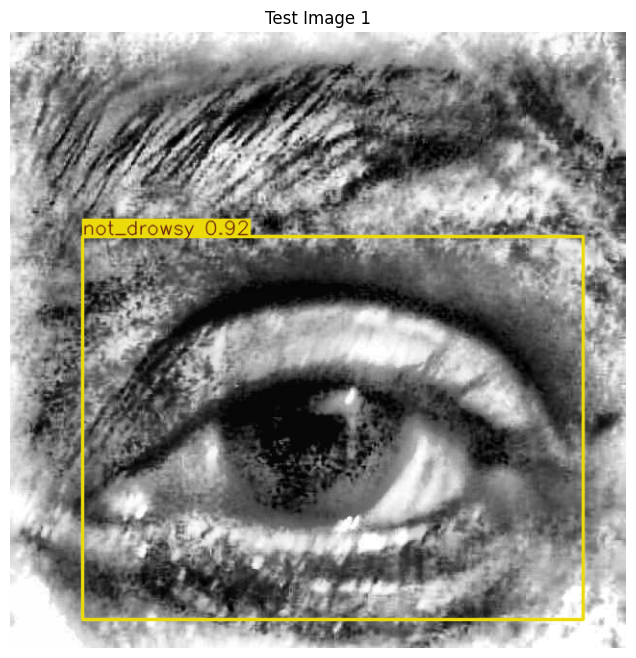

✅ Saved: output_image_2.jpg


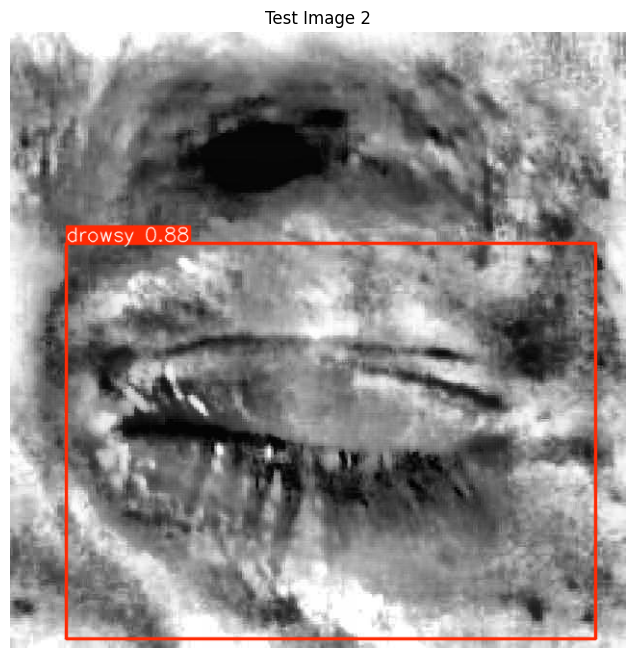

✅ Saved: output_image_3.jpg


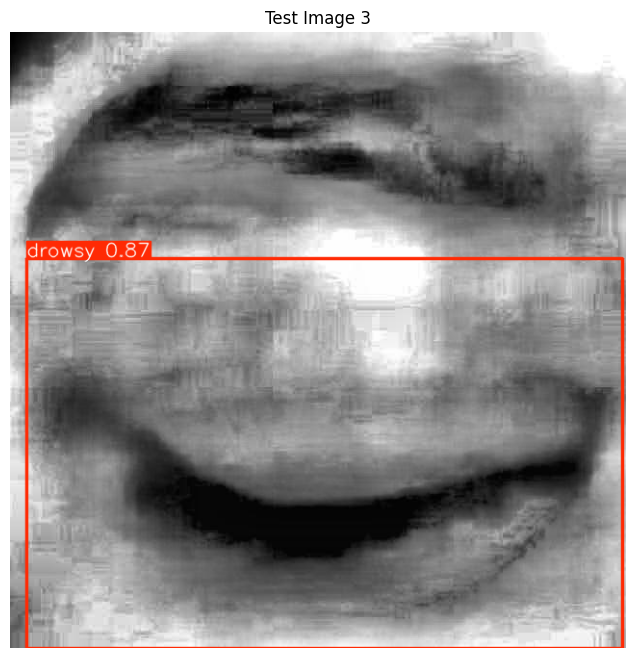

✅ Saved: output_image_4.jpg


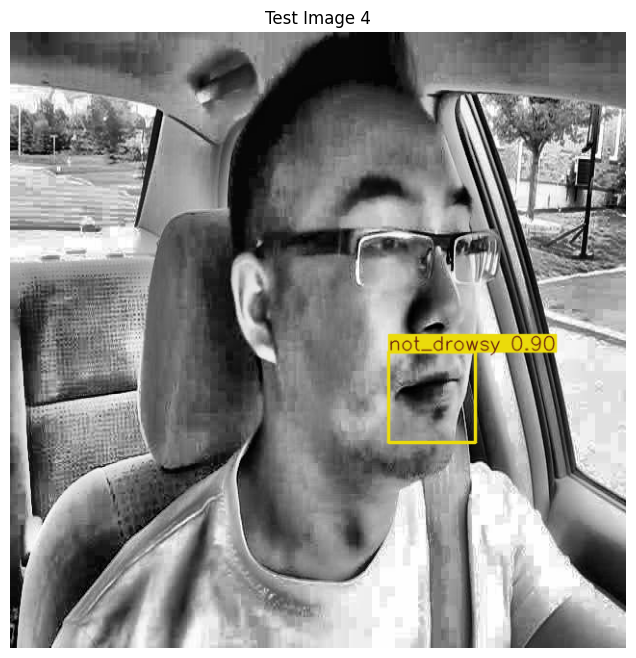

✅ Saved: output_image_5.jpg


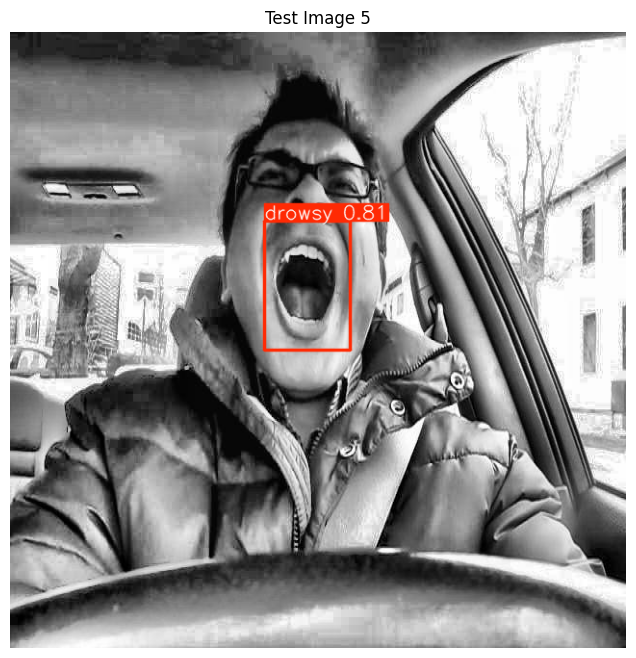

In [ ]:
import cv2
import glob
import torch
import os
import matplotlib.pyplot as plt
from ultralytics import YOLO

#Load the trained YOLOv12n model (Best Weights)
model_path = "runs/detect/yolov12_tuned21/weights/best.pt"  # Ensure correct model path
model = YOLO(model_path)

#Path to test images
test_images = glob.glob("/content/dataset/test/images/*.jpg")  # Adjust path as needed
if not test_images:
    print("No test images found. Check your dataset path.")
test_images = test_images[:5]  # Limit to first 5 images

#Run inference on test images
results = model(test_images, conf=0.5)  # Set confidence threshold

#Display and Save Results
for i, result in enumerate(results):
    # Read the image
    img = cv2.imread(test_images[i])
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Render bounding boxes on image
    img_with_boxes = result.plot()

    #Save the result if needed
    save_path = f"output_image_{i+1}.jpg"
    cv2.imwrite(save_path, cv2.cvtColor(img_with_boxes, cv2.COLOR_RGB2BGR))
    print(f"Saved: {save_path}")

    # Show image with bounding boxes
    plt.figure(figsize=(8, 8))
    plt.imshow(img_with_boxes)
    plt.axis("off")
    plt.title(f"Test Image {i+1}")
    plt.show()


Hybrid- RetinaFace + EfficientNet B0

In [ ]:
!pip install torch torchvision torchaudio
!pip install numpy opencv-python matplotlib pillow tqdm
!pip install insightface onnxruntime
!pip install pretrainedmodels

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 73.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 54.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 29.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 3.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 82.6 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitlin

In [ ]:
import cv2
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, Dataset
from torchvision import models
import numpy as np
import os
from insightface.app import FaceAnalysis
from PIL import Image
from tqdm import tqdm
import gc
import warnings
import onnxruntime
# GPU/CPU Memory Optimization
torch.cuda.empty_cache()
gc.collect()

# Suppress FutureWarnings
warnings.simplefilter(action='ignore', category=FutureWarning)

# Initialize RetinaFace with CPU
onnx_providers = onnxruntime.get_available_providers()
if 'CUDAExecutionProvider' in onnx_providers:
    face_detector = FaceAnalysis(name='buffalo_l', providers=['CUDAExecutionProvider', 'CPUExecutionProvider'])
else:
    print("⚠ CUDAExecutionProvider not available, running on CPU!")
    face_detector = FaceAnalysis(name='buffalo_l', providers=['CPUExecutionProvider'])

face_detector.prepare(ctx_id=0, det_size=(320, 320))

# Custom Dataset
class CustomDataset(Dataset):
    def __init__(self, image_dir, label_dir, transform=None):
        self.image_dir = image_dir
        self.label_dir = label_dir
        self.transform = transform
        self.data = [
            (f.replace(".txt", ".jpg"), int(open(os.path.join(label_dir, f)).read().strip().split()[0]))
            for f in os.listdir(label_dir) if os.path.isfile(os.path.join(label_dir, f))
        ]

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        img_name, label = self.data[idx]
        img_path = os.path.join(self.image_dir, img_name)
        image = cv2.imread(img_path)
        image = np.zeros((224, 224, 3), dtype=np.uint8) if image is None else cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Reduce face detection frequency and speed up
        if self.transform:  # Skip face detection during validation
            faces = face_detector.get(image)
            if faces:
                x1, y1, x2, y2 = map(int, faces[0].bbox)
                image = image[max(0, y1):min(image.shape[0], y2), max(0, x1):min(image.shape[1], x2)]

        image = Image.fromarray(cv2.resize(image, (224, 224), interpolation=cv2.INTER_AREA))
        return self.transform(image) if self.transform else image, label

# Data Augmentation
train_transform = transforms.Compose([
    transforms.RandomResizedCrop(224, scale=(0.8, 1.0)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomAffine(degrees=10, translate=(0.1, 0.1)),
    transforms.ColorJitter(0.2, 0.2, 0.2, 0.1),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

test_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])
# Data Loading
train_dataset = CustomDataset("/content/dataset/train/images", "/content/dataset/train/labels", train_transform)
test_dataset = CustomDataset("/content/dataset/test/images", "/content/dataset/test/labels", test_transform)

train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True, num_workers=0, pin_memory=False)
test_loader = DataLoader(test_dataset, batch_size=8, shuffle=False, num_workers=0, pin_memory=False)

# Model Setup
num_classes = 2
model = models.efficientnet_b0(weights=models.EfficientNet_B0_Weights.IMAGENET1K_V1)

# Modify model: remove last layers and set dropout higher to prevent overfitting
model.classifier[1] = nn.Sequential(
    nn.Dropout(0.6),  # Increased dropout to reduce overfitting
    nn.Linear(model.classifier[1].in_features, num_classes)
)
# Device Setup (CPU only)
device = torch.device("cpu")  # Set to CPU
model = model.to(device).to(memory_format=torch.channels_last)

# Loss, Optimizer & Scheduler
criterion = nn.CrossEntropyLoss(label_smoothing=0.1)
optimizer = optim.AdamW(model.parameters(), lr=0.0002, weight_decay=2e-3)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2, verbose=True)

# Early Stopping Check
def early_stopping(val_accuracy, threshold=97.0):
    if val_accuracy > threshold:
        return True
    return False

# Training Loop with Model Saving
epochs = 10  # Set for 10 epochs
grad_accum_steps = 4
best_val_loss = float('inf')
best_model_path = "drowsiness_detection_model.pth"  # Saved as drowsiness_detection_model.pth

for epoch in range(1, epochs + 1):
    model.train()
    running_loss, correct, total = 0.0, 0, 0

    with tqdm(total=len(train_loader), desc=f"Epoch [{epoch}/{epochs}]", unit="batch") as pbar:
        for step, (images, labels) in enumerate(train_loader):
            images, labels = images.to(device, memory_format=torch.channels_last), labels.to(device)
            optimizer.zero_grad()

            outputs = model(images)
            loss = criterion(outputs, labels) / grad_accum_steps

            loss.backward()

            if (step + 1) % grad_accum_steps == 0:
                torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
                optimizer.step()

            running_loss += loss.item() * grad_accum_steps
            _, predicted = torch.max(outputs, 1)
            correct += (predicted == labels).sum().item()
            total += labels.size(0)

            pbar.set_postfix(loss=loss.item() * grad_accum_steps)
            pbar.update(1)

    # Learning Rate Scheduler
    scheduler.step(running_loss / len(train_loader))
    train_accuracy = 100 * correct / total
    print(f"Epoch [{epoch}/{epochs}] - Loss: {running_loss/len(train_loader):.4f}, Accuracy: {train_accuracy:.2f}%")

    # Validation Phase
    model.eval()
    correct, total, val_loss = 0, 0, 0.0

    with torch.no_grad():
        for images, labels in test_loader:
            images, labels = images.to(device, memory_format=torch.channels_last), labels.to(device)
            outputs = model(images)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
            _, predicted = torch.max(outputs, 1)
            correct += (predicted == labels).sum().item()
            total += labels.size(0)

    val_accuracy = 100 * correct / total
    print(f"Validation - Loss: {val_loss/len(test_loader):.4f}, Accuracy: {val_accuracy:.2f}%\n")

    # Save Best Model
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        torch.save(model.state_dict(), best_model_path)
        print(f" Model saved as {best_model_path}")

    # Early Stopping: Stop if accuracy > 97%

    if early_stopping(val_accuracy, threshold=97.0):
        print(" Stopping training: Accuracy exceeded 97%.")
        break
print(f"Best model saved at: {best_model_path}")

⚠ CUDAExecutionProvider not available, running on CPU!
download_path: /root/.insightface/models/buffalo_l


100%|██████████| 281857/281857 [00:04<00:00, 70440.36KB/s]


Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/1k3d68.onnx landmark_3d_68 ['None', 3, 192, 192] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/2d106det.onnx landmark_2d_106 ['None', 3, 192, 192] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/det_10g.onnx detection [1, 3, '?', '?'] 127.5 128.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/genderage.onnx genderage ['None', 3, 96, 96] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: /root/.insightface/models/buffalo_l/w600k_r50.onnx recognition ['None', 3, 112, 112] 127.5 127.5
set det-size: (320, 320)


Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-7f5810bc.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b0_rwightman-7f5810bc.pth
100%|██████████| 20.5M/20.5M [00:00<00:00, 114MB/s] 
/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
Epoch [1/10]: 100%|██████████| 501/501 [36:30<00:00,  4.37s/batch, loss=0.968]


Epoch [1/10] - Loss: 0.5594, Accuracy: 70.86%
Validation - Loss: 0.3578, Accuracy: 90.54%

✅ Model saved as drowsiness_detection_model.pth


Epoch [2/10]: 100%|██████████| 501/501 [36:18<00:00,  4.35s/batch, loss=0.713]


Epoch [2/10] - Loss: 0.4124, Accuracy: 86.54%
Validation - Loss: 0.2790, Accuracy: 96.42%

✅ Model saved as drowsiness_detection_model.pth


Epoch [3/10]: 100%|██████████| 501/501 [36:16<00:00,  4.34s/batch, loss=0.223]


Epoch [3/10] - Loss: 0.3832, Accuracy: 88.69%
Validation - Loss: 0.2516, Accuracy: 98.21%

✅ Model saved as drowsiness_detection_model.pth
🚀 Stopping training: Accuracy exceeded 97%.
Best model saved at: drowsiness_detection_model.pth


In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
# Evaluate on Train Set
# Load the best model
model.load_state_dict(torch.load(best_model_path))
model.eval()

train_all_labels = []
train_all_predictions = []

with torch.no_grad():
    for images, labels in train_loader:
        images, labels = images.to(device, memory_format=torch.channels_last), labels.to(device)
        outputs = model(images)
        _, predicted = torch.max(outputs, 1)

        train_all_labels.extend(labels.cpu().numpy())
        train_all_predictions.extend(predicted.cpu().numpy())

# Calculate Accuracy, Precision, Recall, F1-Score for the train set
train_accuracy = accuracy_score(train_all_labels, train_all_predictions)
train_precision = precision_score(train_all_labels, train_all_predictions, average='weighted')
train_recall = recall_score(train_all_labels, train_all_predictions, average='weighted')
train_f1 = f1_score(train_all_labels, train_all_predictions, average='weighted')

# Print the Evaluation Metrics for Train Set
print(f"Train Accuracy: {train_accuracy:.4f}")
print(f"Train Precision: {train_precision:.4f}")
print(f"Train Recall: {train_recall:.4f}")
print(f"Train F1-Score: {train_f1:.4f}")

Train Accuracy: 0.9576
Train Precision: 0.9577
Train Recall: 0.9576
Train F1-Score: 0.9575


In [ ]:
# Validation Phase Evaluation Metrics
# During the validation phase of each epoch
model.eval()
val_correct, val_total = 0, 0
val_loss = 0.0
val_all_labels = []
val_all_predictions = []

with torch.no_grad():
    for images, labels in test_loader:  # Change `test_loader` to `val_loader` if using a separate validation set
        images, labels = images.to(device, memory_format=torch.channels_last), labels.to(device)
        outputs = model(images)
        loss = criterion(outputs, labels)
        val_loss += loss.item()

        _, predicted = torch.max(outputs, 1)
        val_correct += (predicted == labels).sum().item()
        val_total += labels.size(0)

        val_all_labels.extend(labels.cpu().numpy())
        val_all_predictions.extend(predicted.cpu().numpy())

# Calculate Accuracy, Precision, Recall, F1-Score for Validation
val_accuracy = 100 * val_correct / val_total
val_precision = precision_score(val_all_labels, val_all_predictions, average='weighted')
val_recall = recall_score(val_all_labels, val_all_predictions, average='weighted')
val_f1 = f1_score(val_all_labels, val_all_predictions, average='weighted')

# Confusion Matrix for Validation
val_conf_matrix = confusion_matrix(val_all_labels, val_all_predictions)

# Print the Validation Evaluation Metrics
print(f"Validation - Loss: {val_loss/len(test_loader):.4f}")
print(f"Validation Accuracy: {val_accuracy:.4f}")
print(f"Validation Precision: {val_precision:.4f}")
print(f"Validation Recall: {val_recall:.4f}")
print(f"Validation F1-Score: {val_f1:.4f}")

Validation - Loss: 0.2516
Validation Accuracy: 98.2097
Validation Precision: 0.9823
Validation Recall: 0.9821
Validation F1-Score: 0.9821


In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Load the best model
model.load_state_dict(torch.load(best_model_path))
model.eval()

test_all_labels = []
test_all_predictions = []

# No gradients needed for evaluation
with torch.no_grad():
    for images, labels in test_loader:
        images, labels = images.to(device, memory_format=torch.channels_last), labels.to(device)
        outputs = model(images)
        _, predicted = torch.max(outputs, 1)

        # Collect all predictions and labels
        test_all_labels.extend(labels.cpu().numpy())
        test_all_predictions.extend(predicted.cpu().numpy())

# Calculate Accuracy, Precision, Recall, F1-Score for the test set
test_accuracy = accuracy_score(test_all_labels, test_all_predictions)
test_precision = precision_score(test_all_labels, test_all_predictions, average='weighted')
test_recall = recall_score(test_all_labels, test_all_predictions, average='weighted')
test_f1 = f1_score(test_all_labels, test_all_predictions, average='weighted')

# Print the Evaluation Metrics for Test Set
print(f"Test Accuracy: {test_accuracy:.4f}")
print(f"Test Precision: {test_precision:.4f}")
print(f"Test Recall: {test_recall:.4f}")
print(f"Test F1-Score: {test_f1:.4f}")

Test Accuracy: 0.9821
Test Precision: 0.9823
Test Recall: 0.9821
Test F1-Score: 0.9821


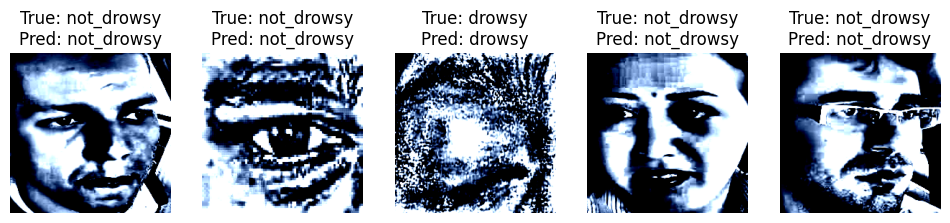

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import torch
from PIL import Image
# Run the model on First 5 Images and Display Actual vs Predicted
# Load the best model
model.load_state_dict(torch.load(best_model_path))
model.eval()

# Define the class labels
class_names = ['drowsy', 'not_drowsy']

# Set up lists to store the images, actual labels, and predicted labels
images_to_display = []
actual_labels = []
predicted_labels = []

# Process only the first 5 images from the test set
with torch.no_grad():
    for i, (images, labels) in enumerate(test_loader):
        if i >= 1:  # Process only the first batch (first 5 images)
            break

        images, labels = images.to(device, memory_format=torch.channels_last), labels.to(device)
        outputs = model(images)
        _, predicted = torch.max(outputs, 1)

        # Store the images, actual labels, and predicted labels
        images_to_display.extend(images.cpu().numpy())
        actual_labels.extend(labels.cpu().numpy())
        predicted_labels.extend(predicted.cpu().numpy())

# Plot the first 5 images with actual vs predicted labels
plt.figure(figsize=(12, 6))

for i in range(5):
    plt.subplot(1, 5, i + 1)
    img = images_to_display[i].transpose(1, 2, 0)  # Reorder to (H, W, C) for visualization
    img = np.clip(img, 0, 1)  # Clip values to be between 0 and 1

    # Display the image
    plt.imshow(img)
    plt.title(f"True: {class_names[actual_labels[i]]}\nPred: {class_names[predicted_labels[i]]}")
    plt.axis('off')

plt.show()

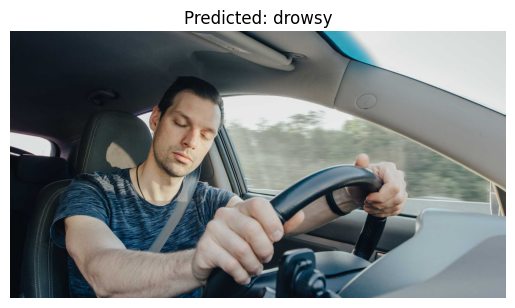

Predicted label: drowsy


In [ ]:
import torch
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt
import requests
from io import BytesIO

# Predict on an Image from URL
# URL of the image you want to predict
image_url = 'https://assets-global.website-files.com/595d6b420002832258c527cb/618abc9cdfbae01bc36d2ce5_hero_advanced_drowsiness.jpg'  # Replace with your image URL

# Download the image from the URL
response = requests.get(image_url)
image = Image.open(BytesIO(response.content))

# Define the transformation (make sure to use the same transforms used during training)
transform = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize to match input size of your model
    transforms.ToTensor(),          # Convert image to tensor
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])  # Normalize based on ImageNet statistics
])

# Apply the transformation
image_tensor = transform(image).unsqueeze(0)  # Add batch dimension

# Load the model (ensure the model is in evaluation mode)
model.eval()

# Make the prediction
with torch.no_grad():
    image_tensor = image_tensor.to(device)  # Move the tensor to the correct device (GPU or CPU)
    outputs = model(image_tensor)
    _, predicted = torch.max(outputs, 1)

# Convert prediction to label
class_names = ['drowsy', 'not_drowsy']
predicted_label = class_names[predicted.item()]

# Display the image and prediction
plt.imshow(image)
plt.title(f"Predicted: {predicted_label}")
plt.axis('off')
plt.show()

# Print the predicted label
print(f"Predicted label: {predicted_label}")

YoloV8 + DETR

In [ ]:
import os
import json
import glob
from tqdm import tqdm
from PIL import Image
import yaml

# Define dataset paths
dataset_path = "/content/dataset"

splits = ["train", "valid", "test"]
image_dirs = {split: os.path.join(dataset_path, split, "images") for split in splits}
label_dirs = {split: os.path.join(dataset_path, split, "labels") for split in splits}
output_jsons = {split: os.path.join(dataset_path, f"coco_{split}.json") for split in splits}

# Load class names from data.yaml
yaml_path = os.path.join(dataset_path, "data.yaml")
with open(yaml_path, "r") as f:
    yolo_data = yaml.safe_load(f)
    class_names = yolo_data.get("names", [])
num_classes = len(class_names)

# Create COCO categories
categories = [{"id": i, "name": name, "supercategory": "object"} for i, name in enumerate(class_names)]

def convert_yolo_to_coco(labels_dir, images_dir, output_json):
    coco_data = {"images": [], "annotations": [], "categories": categories}
    annotation_id, image_id = 1, 1

    for label_path in tqdm(glob.glob(os.path.join(labels_dir, "*.txt"))):
        img_filename = os.path.basename(label_path).replace(".txt", ".jpg")  # Change extension if needed
        img_path = os.path.join(images_dir, img_filename)

        # Skip if image doesn't exist
        if not os.path.exists(img_path):
            print(f" Warning: Image {img_path} not found, skipping.")
            continue

        img = Image.open(img_path)
        width, height = img.size

        # Add image to COCO dataset
        coco_data["images"].append({
            "id": image_id,
            "file_name": img_filename,
            "width": width,
            "height": height
        })

        # Read YOLO labels
        with open(label_path, "r") as f:
            lines = f.readlines()

        for line in lines:
            parts = line.strip().split()
            if len(parts) < 5:
                continue  # Skip invalid lines

            class_id, x_center, y_center, w, h = map(float, parts)
            x_min, y_min = (x_center - w / 2) * width, (y_center - h / 2) * height
            w, h = w * width, h * height

            # Add annotation
            coco_data["annotations"].append({
                "id": annotation_id,
                "image_id": image_id,
                "category_id": int(class_id),
                "bbox": [x_min, y_min, w, h],
                "area": w * h,
                "iscrowd": 0
            })
            annotation_id += 1

        image_id += 1

    # Save to COCO JSON
    with open(output_json, "w") as f:
        json.dump(coco_data, f, indent=4)
    print(f"COCO file saved: {output_json}")

# Convert train, val, and test sets
for split in splits:
    if os.path.exists(label_dirs[split]) and os.path.exists(image_dirs[split]):
        convert_yolo_to_coco(label_dirs[split], image_dirs[split], output_jsons[split])

100%|██████████| 4005/4005 [00:00<00:00, 8050.12it/s]


✅ COCO file saved: /content/dataset/coco_train.json


100%|██████████| 783/783 [00:00<00:00, 9583.16it/s]


✅ COCO file saved: /content/dataset/coco_valid.json


100%|██████████| 782/782 [00:00<00:00, 9614.49it/s]


✅ COCO file saved: /content/dataset/coco_test.json


In [ ]:
import json
# Paths to COCO JSON files
json_paths = [
    "/content/dataset/coco_train.json",
    "/content/dataset/coco_valid.json",
    "/content/dataset/coco_test.json"
]

for path in json_paths:
    print(f"\nChecking: {path}")
    try:
        with open(path, "r") as f:
            coco_data = json.load(f)

        # Check structure
        print(f"Found {len(coco_data['images'])} images and {len(coco_data['annotations'])} annotations")
        print(f"Categories: {coco_data['categories']}\n")

        # Show a sample image & annotation
        if len(coco_data["images"]) > 0:
            print("Sample Image Entry:", coco_data["images"][0])

        if len(coco_data["annotations"]) > 0:
            print("Sample Annotation Entry:", coco_data["annotations"][0])

    except Exception as e:
        print(f"Error reading {path}: {e}")


🔍 Checking: /content/dataset/coco_train.json
✅ Found 4005 images and 4008 annotations
📂 Categories: [{'id': 0, 'name': 'drowsy', 'supercategory': 'object'}, {'id': 1, 'name': 'not_drowsy', 'supercategory': 'object'}]

🖼️ Sample Image Entry: {'id': 1, 'file_name': '723_jpg.rf.e07f55ebb9c7164dff48aa307ec77d47.jpg', 'width': 640, 'height': 640}
✏️ Sample Annotation Entry: {'id': 1, 'image_id': 1, 'category_id': 0, 'bbox': [246.5, 222.0, 143.0, 120.0], 'area': 17160.0, 'iscrowd': 0}

🔍 Checking: /content/dataset/coco_valid.json
✅ Found 783 images and 784 annotations
📂 Categories: [{'id': 0, 'name': 'drowsy', 'supercategory': 'object'}, {'id': 1, 'name': 'not_drowsy', 'supercategory': 'object'}]

🖼️ Sample Image Entry: {'id': 1, 'file_name': '1561_jpg.rf.4fc6fc0d67ea0ea1fc48f93318160282.jpg', 'width': 640, 'height': 640}
✏️ Sample Annotation Entry: {'id': 1, 'image_id': 1, 'category_id': 1, 'bbox': [374.0, 300.5, 70.0, 36.0], 'area': 2520.0, 'iscrowd': 0}

🔍 Checking: /content/dataset/coco

In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

In [ ]:
!pip install ultralytics
from ultralytics import YOLO
# Load YOLOv8 model (use yolov8n.pt, yolov8m.pt, or yolov8l.pt for better accuracy)
model = YOLO("yolov8n.pt")
# Train with optimized settings
model.train(
    data="/content/dataset/data.yaml",  # Path to dataset
    epochs=50,             # Max epochs
    imgsz=416,             # Reduce image size for faster training
    batch=8,               # Reduce batch size if GPU memory is low
    amp=True,              # Mixed precision for speedup
    cache=True,            # Cache dataset for faster loading
    patience=5,            # Early stopping (stops if no improvement for 5 epochs)
    weight_decay=0.0005,   # L2 regularization (prevents overfitting)
    hsv_h=0.015,           # Hue augmentation
    hsv_s=0.7,             # Saturation augmentation
    hsv_v=0.4,             # Value (brightness) augmentation
    flipud=0.5,            # Vertical flip probability
    fliplr=0.5,            # Horizontal flip probability
    mosaic=1.0,            # Mosaic augmentation
    mixup=0.2              # Mixup augmentation (blends images)
)

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 922.2/922.2 kB 52.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 113.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 81.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 50.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 20.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 47.2 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstal

100%|██████████| 6.25M/6.25M [00:00<00:00, 332MB/s]


Ultralytics 8.3.85 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/dataset/data.yaml, epochs=50, time=None, patience=5, batch=8, imgsz=416, save=True, save_period=-1, cache=True, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=Tru

100%|██████████| 755k/755k [00:00<00:00, 107MB/s]


Overriding model.yaml nc=80 with nc=2

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 259MB/s]


AMP: checks passed ✅


train: Scanning /content/dataset/train/labels... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:05<00:00, 759.40it/s]


train: New cache created: /content/dataset/train/labels.cache
WARNING ⚠️ cache='ram' may produce non-deterministic training results. Consider cache='disk' as a deterministic alternative if your disk space allows.


train: Caching images (1.9GB RAM): 100%|██████████| 4005/4005 [00:13<00:00, 299.33it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/dataset/valid/labels... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:01<00:00, 587.06it/s]

val: New cache created: /content/dataset/valid/labels.cache


WARNING ⚠️ cache='ram' may produce non-deterministic training results. Consider cache='disk' as a deterministic alternative if your disk space allows.


val: Caching images (0.4GB RAM): 100%|██████████| 783/783 [00:02<00:00, 344.24it/s]


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 416 train, 416 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50     0.531G      1.335       1.96      1.624         19        416: 100%|██████████| 501/501 [01:04<00:00,  7.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:06<00:00,  7.13it/s]


                   all        783        784      0.506      0.476      0.458      0.182

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50     0.506G       1.22      1.401      1.483         15        416: 100%|██████████| 501/501 [01:02<00:00,  8.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:04<00:00, 10.50it/s]


                   all        783        784      0.579      0.594      0.568      0.279

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50     0.502G      1.162      1.259      1.432         23        416: 100%|██████████| 501/501 [01:03<00:00,  7.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:05<00:00,  8.72it/s]

                   all        783        784      0.801      0.725      0.793       0.38



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50     0.496G      1.093      1.146       1.38         16        416: 100%|██████████| 501/501 [01:01<00:00,  8.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:05<00:00,  9.31it/s]


                   all        783        784      0.772      0.766      0.844       0.43

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50     0.506G      1.024      1.038      1.332         19        416: 100%|██████████| 501/501 [01:01<00:00,  8.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:04<00:00, 10.41it/s]


                   all        783        784      0.795      0.818      0.859      0.435

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50     0.496G     0.9719     0.9712      1.309         19        416: 100%|██████████| 501/501 [01:03<00:00,  7.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:05<00:00,  9.75it/s]

                   all        783        784      0.826      0.833      0.891       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50     0.506G       0.92     0.8955      1.273         15        416: 100%|██████████| 501/501 [01:00<00:00,  8.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:05<00:00,  8.63it/s]


                   all        783        784      0.846      0.809      0.889       0.48

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50     0.502G     0.8879     0.8818      1.257         11        416: 100%|██████████| 501/501 [01:02<00:00,  8.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:04<00:00, 10.62it/s]

                   all        783        784      0.881      0.801      0.904      0.457



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50     0.496G     0.8425     0.8414      1.236         11        416: 100%|██████████| 501/501 [01:01<00:00,  8.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:04<00:00, 10.41it/s]

                   all        783        784      0.884      0.855      0.947      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50       0.5G      0.829     0.8023       1.22         13        416: 100%|██████████| 501/501 [01:03<00:00,  7.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:05<00:00,  8.60it/s]

                   all        783        784      0.885      0.842       0.93      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50     0.508G     0.8065     0.7773      1.211         21        416: 100%|██████████| 501/501 [01:01<00:00,  8.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:05<00:00,  8.85it/s]

                   all        783        784      0.873      0.837       0.92      0.499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50       0.5G     0.7774     0.7507      1.194         13        416: 100%|██████████| 501/501 [01:01<00:00,  8.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:04<00:00, 10.57it/s]

                   all        783        784        0.9      0.878      0.948       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50     0.496G     0.7706     0.7459       1.19         20        416: 100%|██████████| 501/501 [01:02<00:00,  7.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:04<00:00, 10.64it/s]

                   all        783        784      0.875      0.904      0.934       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50       0.5G      0.736     0.7006      1.167         16        416: 100%|██████████| 501/501 [01:00<00:00,  8.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:05<00:00,  9.39it/s]

                   all        783        784      0.904       0.89      0.954      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50     0.506G     0.7407     0.7117       1.17         21        416: 100%|██████████| 501/501 [01:00<00:00,  8.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:05<00:00,  8.87it/s]

                   all        783        784      0.922      0.904      0.954      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50       0.5G     0.7277      0.684      1.167          9        416: 100%|██████████| 501/501 [01:01<00:00,  8.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:04<00:00, 10.55it/s]

                   all        783        784      0.901      0.895      0.951      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50     0.496G     0.7156     0.6776      1.164         10        416: 100%|██████████| 501/501 [01:02<00:00,  8.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:04<00:00, 10.73it/s]

                   all        783        784      0.899      0.896      0.943      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50     0.496G     0.6899     0.6547      1.148         13        416: 100%|██████████| 501/501 [01:00<00:00,  8.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:04<00:00, 10.29it/s]

                   all        783        784      0.904      0.878      0.941      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50     0.506G     0.6701     0.6313      1.135         13        416: 100%|██████████| 501/501 [00:59<00:00,  8.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:05<00:00,  9.05it/s]

                   all        783        784      0.892      0.892      0.942      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50       0.5G     0.6596     0.6208      1.127         13        416: 100%|██████████| 501/501 [01:04<00:00,  7.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:04<00:00, 10.68it/s]

                   all        783        784      0.921      0.896      0.959      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50     0.496G     0.6629     0.6281      1.137         16        416: 100%|██████████| 501/501 [01:02<00:00,  8.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:04<00:00, 10.59it/s]

                   all        783        784      0.932       0.93      0.961      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50     0.498G     0.6462     0.5994      1.123         11        416: 100%|██████████| 501/501 [01:00<00:00,  8.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:04<00:00, 10.57it/s]

                   all        783        784      0.945      0.929      0.967      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50     0.504G     0.6277     0.5892      1.112         19        416: 100%|██████████| 501/501 [01:00<00:00,  8.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:05<00:00,  8.95it/s]

                   all        783        784      0.938      0.925      0.963      0.553



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50     0.502G       0.62     0.5892      1.112         21        416: 100%|██████████| 501/501 [01:00<00:00,  8.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:05<00:00,  8.72it/s]

                   all        783        784       0.95      0.939      0.969      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50     0.496G     0.6257     0.5876      1.113         12        416: 100%|██████████| 501/501 [01:01<00:00,  8.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:04<00:00, 10.50it/s]

                   all        783        784      0.946       0.92      0.963      0.543



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50     0.496G     0.6123     0.5702      1.102         17        416: 100%|██████████| 501/501 [01:01<00:00,  8.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:04<00:00, 10.61it/s]

                   all        783        784      0.945      0.925      0.968      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50     0.504G     0.6102     0.5654      1.106         11        416: 100%|██████████| 501/501 [01:01<00:00,  8.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:04<00:00, 10.81it/s]

                   all        783        784      0.943      0.949      0.975      0.582



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50       0.5G      0.593     0.5485      1.094          9        416: 100%|██████████| 501/501 [01:01<00:00,  8.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:05<00:00,  8.64it/s]

                   all        783        784      0.957      0.937      0.975      0.572



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50     0.498G     0.5951     0.5552      1.102         15        416: 100%|██████████| 501/501 [01:00<00:00,  8.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:05<00:00,  8.95it/s]

                   all        783        784      0.942       0.95       0.97      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50     0.498G     0.5795     0.5442      1.091         18        416: 100%|██████████| 501/501 [01:01<00:00,  8.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:04<00:00, 10.68it/s]


                   all        783        784      0.945      0.949      0.972      0.561

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50     0.506G      0.567     0.5359      1.088         17        416: 100%|██████████| 501/501 [01:00<00:00,  8.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:05<00:00,  9.70it/s]

                   all        783        784      0.942      0.954      0.977      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50       0.5G     0.5629     0.5262      1.085         11        416: 100%|██████████| 501/501 [01:01<00:00,  8.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:04<00:00, 10.68it/s]

                   all        783        784      0.962      0.927      0.972      0.573
EarlyStopping: Training stopped early as no improvement observed in last 5 epochs. Best results observed at epoch 27, best model saved as best.pt.
To update EarlyStopping(patience=5) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



32 epochs completed in 0.601 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.85 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:05<00:00,  8.39it/s]


                   all        783        784      0.943      0.949      0.975      0.581
                drowsy        381        381      0.945      0.944      0.974       0.57
            not_drowsy        402        403      0.941      0.954      0.975      0.592
Speed: 0.1ms preprocess, 1.6ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to runs/detect/train


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7ca530029510>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
          0.04804

In [ ]:
# Validate on the training dataset
metrics_train = model.val(split='train')  # Run validation on training set

# Print training accuracy
print(" Training Set Performance:")
print(f"  - Precision: {metrics_train.box.p[0]:.4f}")  # Access precision for class 0
print(f"  - Recall: {metrics_train.box.r[0]:.4f}")      # Access recall for class 0
print(f"  - mAP@50: {metrics_train.box.map50:.4f}")  # Access mAP@50
print(f"  - mAP@50-95: {metrics_train.box.map:.4f}") # Access mAP@50-95


Ultralytics 8.3.85 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)


val: Scanning /content/dataset/train/labels.cache... 4005 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4005/4005 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 251/251 [00:31<00:00,  7.89it/s]


                   all       4005       4008      0.941      0.925      0.972      0.612
                drowsy       1992       1995      0.945      0.916      0.971      0.612
            not_drowsy       2013       2013      0.937      0.934      0.973      0.612
Speed: 0.2ms preprocess, 2.0ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to runs/detect/val3
🔹 Training Set Performance:
  - Precision: 0.9447
  - Recall: 0.9165
  - mAP@50: 0.9720
  - mAP@50-95: 0.6120


In [ ]:
# Validate on the validation dataset
metrics_val = model.val()  # Default is validation split

# Print validation accuracy
print("\n Validation Set Performance:")
print(f"  - Precision: {metrics_val.box.p[0]:.4f}")  # Access precision for class 0
print(f"  - Recall: {metrics_val.box.r[0]:.4f}")      # Access recall for class 0
print(f"  - mAP@50: {metrics_val.box.map50:.4f}")  # Access mAP@50
print(f"  - mAP@50-95: {metrics_val.box.map:.4f}") # Access mAP@50-95

Ultralytics 8.3.85 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)


val: Scanning /content/dataset/valid/labels.cache... 783 images, 0 backgrounds, 0 corrupt: 100%|██████████| 783/783 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 49/49 [00:07<00:00,  6.41it/s]


                   all        783        784      0.943       0.95      0.975      0.581
                drowsy        381        381      0.945      0.944      0.974       0.57
            not_drowsy        402        403      0.941      0.955      0.975      0.593
Speed: 0.4ms preprocess, 2.2ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to runs/detect/val6

🔹 Validation Set Performance:
  - Precision: 0.9448
  - Recall: 0.9438
  - mAP@50: 0.9747
  - mAP@50-95: 0.5814


In [ ]:
# Validate on the test dataset
metrics_test = model.val(split='test')  # Run validation on test set

# Print test accuracy
print(" Test Set Performance:")
print(f"  - Precision: {metrics_test.box.p[0]:.4f}")  # Access precision for class 0
print(f"  - Recall: {metrics_test.box.r[0]:.4f}")      # Access recall for class 0
print(f"  - mAP@50: {metrics_test.box.map50:.4f}")  # Access mAP@50
print(f"  - mAP@50-95: {metrics_test.box.map:.4f}") # Access mAP@50-95

Ultralytics 8.3.100 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/dataset/test/labels... 782 images, 0 backgrounds, 0 corrupt: 100%|██████████| 782/782 [00:01<00:00, 689.09it/s]

val: New cache created: /content/dataset/test/labels.cache


WARNING ⚠️ cache='ram' may produce non-deterministic training results. Consider cache='disk' as a deterministic alternative if your disk space allows.


val: Caching images (0.4GB RAM): 100%|██████████| 782/782 [00:03<00:00, 250.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 98/98 [00:05<00:00, 18.67it/s]


                   all        782        786      0.942      0.943      0.974      0.572
                drowsy        403        404      0.938      0.936      0.973      0.567
            not_drowsy        379        382      0.946       0.95      0.976      0.578
Speed: 0.3ms preprocess, 2.2ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to runs/detect/train2
🔹 Test Set Performance:
  - Precision: 0.9383
  - Recall: 0.9356
  - mAP@50: 0.9743
  - mAP@50-95: 0.5723


In [ ]:
!pip install ultralytics transformers torch torchvision matplotlib opencv-python

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/290 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.59k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/102M [00:00<?, ?B/s]

Some weights of the model checkpoint at facebook/detr-resnet-50 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).



image 1/1 /content/dataset/test/images/1029_jpg.rf.c7d357f3a5706db0cede9ee9764c6f8d.jpg: 416x416 1 not_drowsy, 10.0ms
Speed: 2.5ms preprocess, 10.0ms inference, 2.4ms postprocess per image at shape (1, 3, 416, 416)


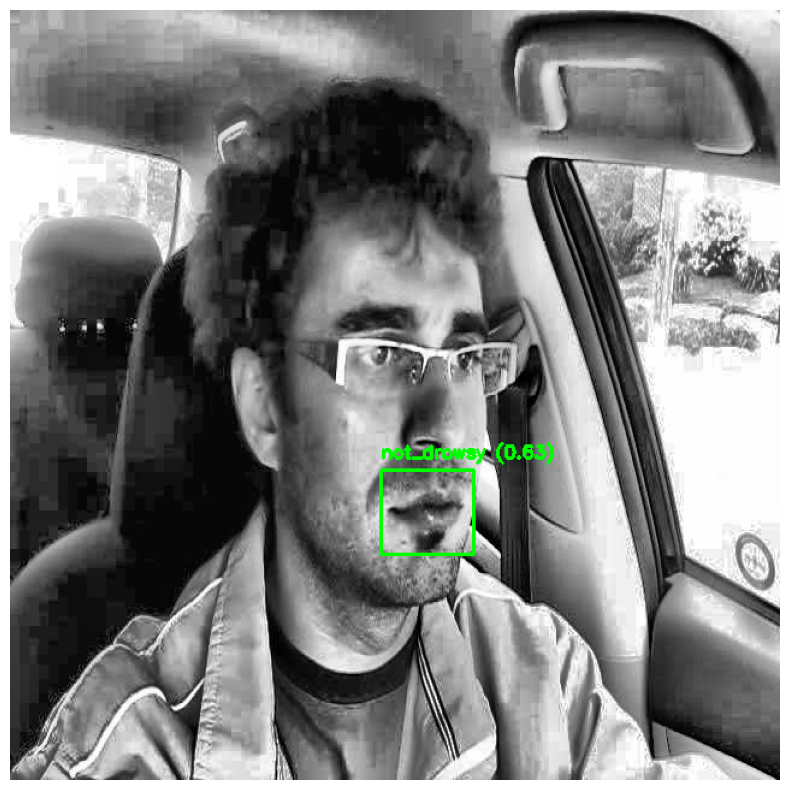

In [ ]:
import torch
import cv2
import numpy as np
import matplotlib.pyplot as plt
from ultralytics import YOLO
from transformers import DetrImageProcessor, DetrForObjectDetection
from PIL import Image

# Load YOLOv8 Model (for face, eyes, and mouth detection)
yolo_model = YOLO("/content/runs/detect/train/weights/best.pt")  # Replace with YOLOv8 model path

# Load Pretrained DETR Model (for refined face classification)
processor = DetrImageProcessor.from_pretrained("facebook/detr-resnet-50")
detr_model = DetrForObjectDetection.from_pretrained("facebook/detr-resnet-50")

# Load an image (Upload your test image in Colab)
image_path = "/content/dataset/test/images/1029_jpg.rf.c7d357f3a5706db0cede9ee9764c6f8d.jpg"  # Test image path
image = cv2.imread(image_path)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Run YOLOv8 Inference
yolo_results = yolo_model(image_path)

# Extract Bounding Boxes from YOLOv8
detected_faces = []
for result in yolo_results:
    for box in result.boxes:
        x1, y1, x2, y2 = map(int, box.xyxy[0])  # Convert box to int
        conf = box.conf[0].item()
        label = result.names[int(box.cls[0].item())]

        if label in ["drowsy", "not_drowsy"]:  # Filter only face detections
            detected_faces.append((x1, y1, x2, y2, conf, label))

# Crop Detected Faces
cropped_faces = []
for (x1, y1, x2, y2, conf, label) in detected_faces:
    cropped_face = image_rgb[y1:y2, x1:x2]
    cropped_faces.append((cropped_face, (x1, y1, x2, y2), conf, label))

# Run DETR on Cropped Faces
final_results = []
for cropped_face, bbox, conf, yolo_label in cropped_faces:
    image_pil = Image.fromarray(cropped_face)
    inputs = processor(images=image_pil, return_tensors="pt")

    with torch.no_grad():
        outputs = detr_model(**inputs)

    # Get DETR Predictions
    logits = outputs.logits[0]  # DETR class scores
    boxes = outputs.pred_boxes[0]  # DETR bounding boxes

    # Convert to (x1, y1, x2, y2)
    scores = logits.softmax(-1)[:, :-1]  # Ignore last "no object" class
    max_score, max_label = scores.max(1)

    # Get the maximum score from the tensor using max_score[0]
    if max_score[0].item() > 0.5:  # Confidence Threshold
        final_label = "drowsy" if max_label.item() == 0 else "not_drowsy"
        final_results.append((bbox, final_label, max_score[0].item())) # Use max_score[0] here as well
    else:
        final_results.append((bbox, yolo_label, conf))  # Use YOLO label if DETR is uncertain

# Draw Final Bounding Boxes on Image
for (x1, y1, x2, y2), label, conf in final_results:
    color = (0, 255, 0) if label == "not_drowsy" else (0, 0, 255)
    cv2.rectangle(image_rgb, (x1, y1), (x2, y2), color, 2)
    cv2.putText(image_rgb, f"{label} ({conf:.2f})", (x1, y1 - 10),
                cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

# Show Final Image
plt.figure(figsize=(10, 10))
plt.imshow(image_rgb)
plt.axis("off")
plt.show()


image 1/1 /content/dataset/test/images/_447_jpg.rf.71fa0819fdefcf959f9f57143e15f11f.jpg: 416x416 1 drowsy, 6.9ms
Speed: 1.5ms preprocess, 6.9ms inference, 1.3ms postprocess per image at shape (1, 3, 416, 416)


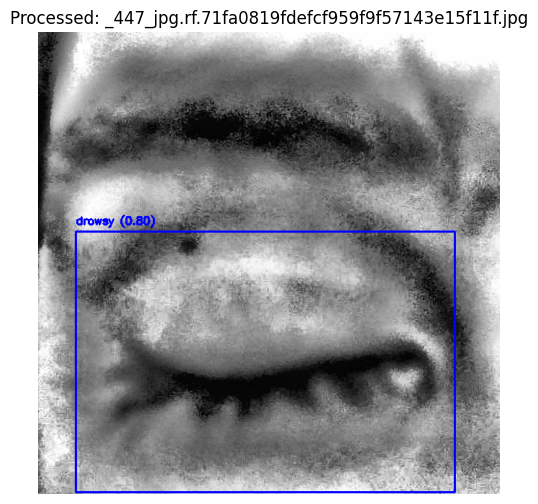


image 1/1 /content/dataset/test/images/_710_jpg.rf.6422a78537ad35018cb152637d422c77.jpg: 416x416 1 not_drowsy, 9.8ms
Speed: 2.7ms preprocess, 9.8ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 416)


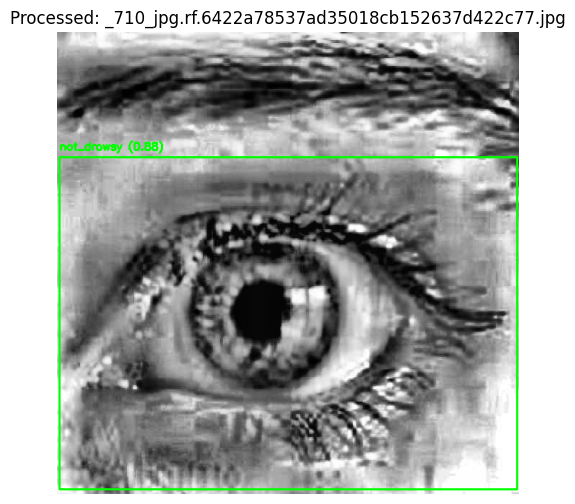


image 1/1 /content/dataset/test/images/523_jpg.rf.75d9a450d3d869dafacd9a2a6aa49f23.jpg: 416x416 1 drowsy, 12.1ms
Speed: 2.4ms preprocess, 12.1ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 416)


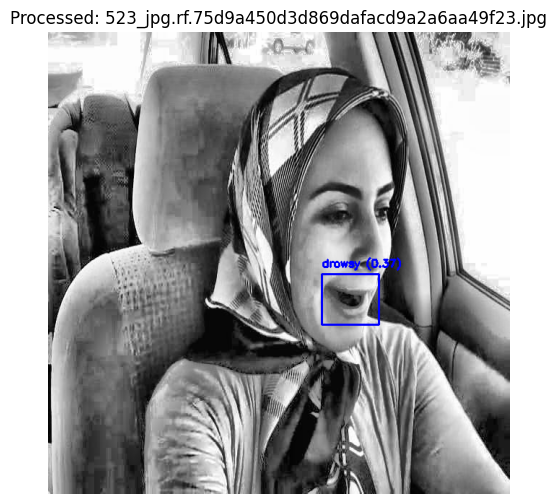


image 1/1 /content/dataset/test/images/_566_jpg.rf.d1965bb988803d780d5457d4d5d8a98b.jpg: 416x416 1 drowsy, 10.1ms
Speed: 2.7ms preprocess, 10.1ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 416)


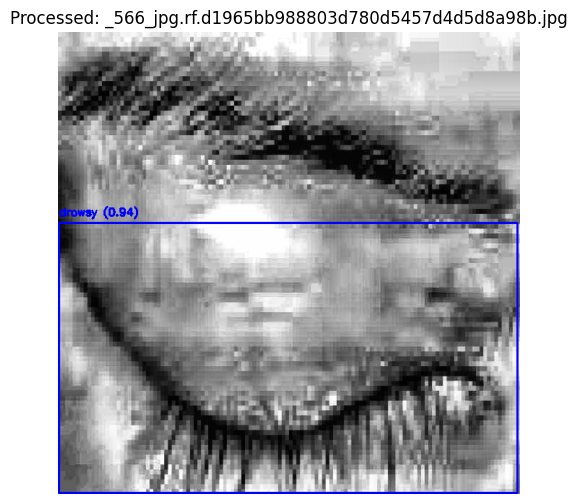


image 1/1 /content/dataset/test/images/1464_jpg.rf.fa51608f173600da313c13a8ab1aaab9.jpg: 416x416 1 not_drowsy, 9.0ms
Speed: 2.4ms preprocess, 9.0ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 416)


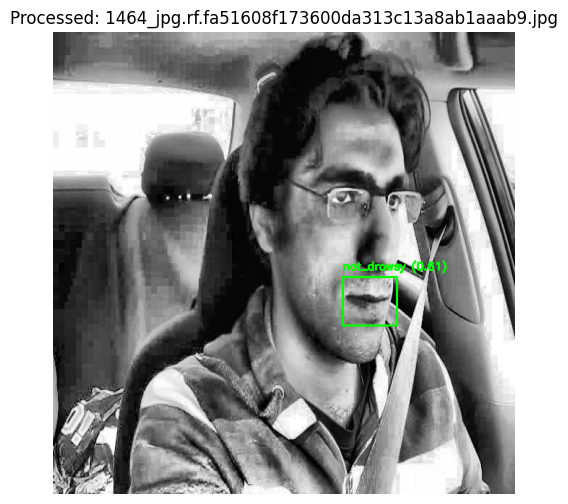


image 1/1 /content/dataset/test/images/452_jpg.rf.4793fdada39d4eb772717d8ebf1e8ea9.jpg: 416x416 1 drowsy, 10.6ms
Speed: 2.6ms preprocess, 10.6ms inference, 2.1ms postprocess per image at shape (1, 3, 416, 416)


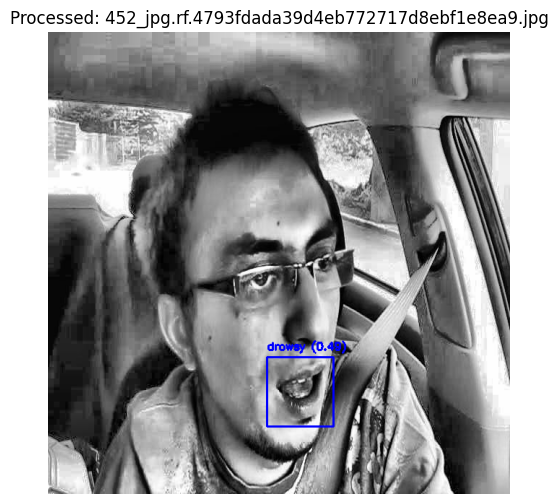


image 1/1 /content/dataset/test/images/_175_jpg.rf.98ddd3840c7c3d03d62e98f5a10667cf.jpg: 416x416 1 drowsy, 9.9ms
Speed: 2.9ms preprocess, 9.9ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 416)


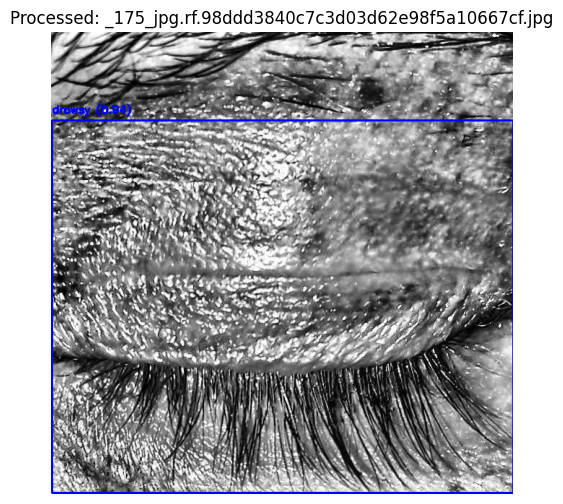


image 1/1 /content/dataset/test/images/_510_jpg.rf.eff00a8f0da75313058389e655236b9b.jpg: 416x416 1 drowsy, 12.9ms
Speed: 3.0ms preprocess, 12.9ms inference, 1.9ms postprocess per image at shape (1, 3, 416, 416)


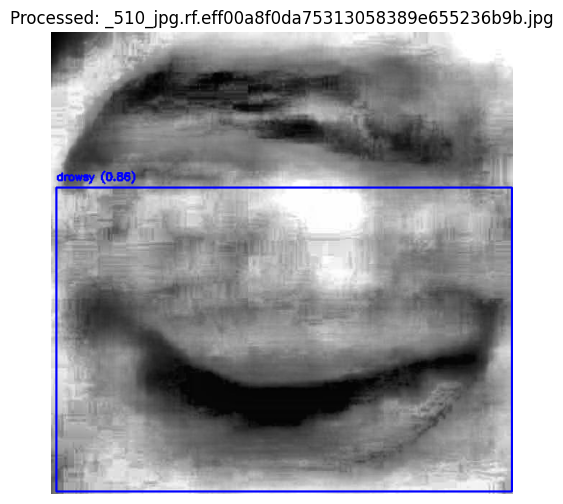


image 1/1 /content/dataset/test/images/_373_jpg.rf.3b20b41e33eb73bc96322e7260ca1f86.jpg: 416x416 1 drowsy, 9.6ms
Speed: 2.5ms preprocess, 9.6ms inference, 1.9ms postprocess per image at shape (1, 3, 416, 416)


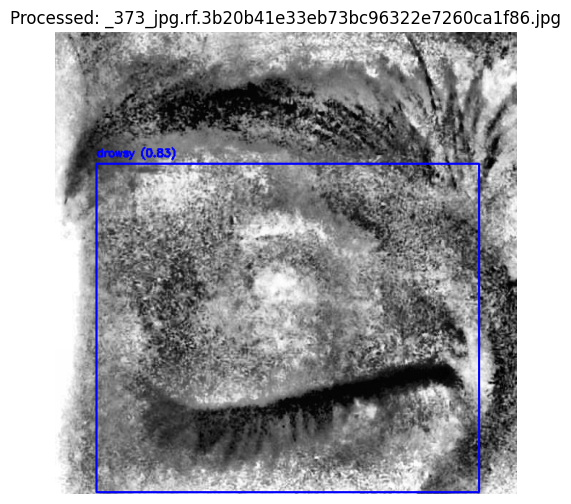


image 1/1 /content/dataset/test/images/162_jpg.rf.3cebf101511e8381651c2226f0f6bdcc.jpg: 416x416 1 drowsy, 10.1ms
Speed: 2.5ms preprocess, 10.1ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 416)


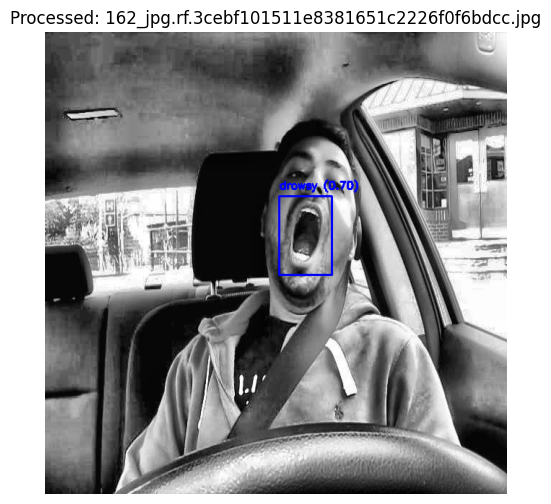


image 1/1 /content/dataset/test/images/_666_jpg.rf.8036f240cd7a54c67f043da0197be9af.jpg: 416x416 1 not_drowsy, 11.7ms
Speed: 2.5ms preprocess, 11.7ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 416)


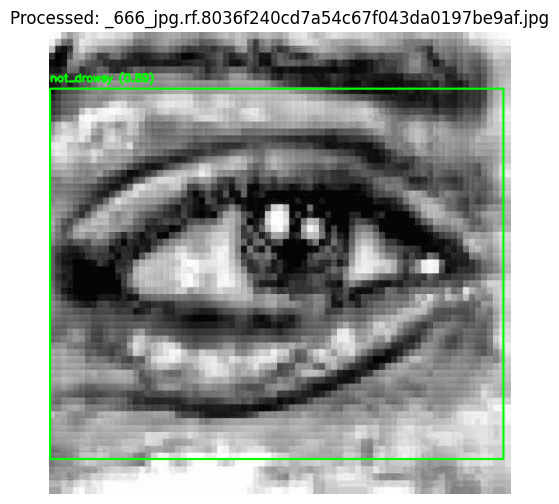


image 1/1 /content/dataset/test/images/638_jpg.rf.8a493c203ff3304b267709d8aca7d9c6.jpg: 416x416 1 not_drowsy, 10.8ms
Speed: 2.4ms preprocess, 10.8ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 416)


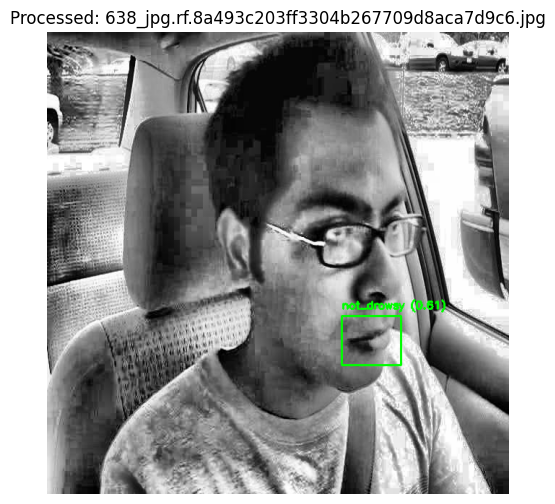


image 1/1 /content/dataset/test/images/_330_jpg.rf.b17b512b0721e972942de70c3ee95130.jpg: 416x416 1 not_drowsy, 12.0ms
Speed: 2.3ms preprocess, 12.0ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 416)


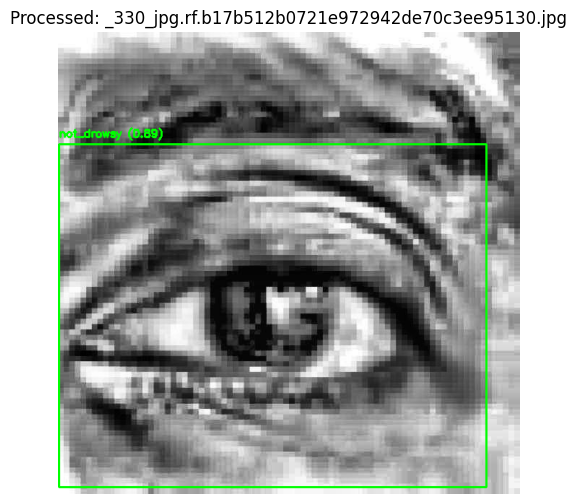


image 1/1 /content/dataset/test/images/_258_jpg.rf.f17e21e59af3366de8cced0e0536a71f.jpg: 416x416 1 drowsy, 10.6ms
Speed: 2.4ms preprocess, 10.6ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 416)


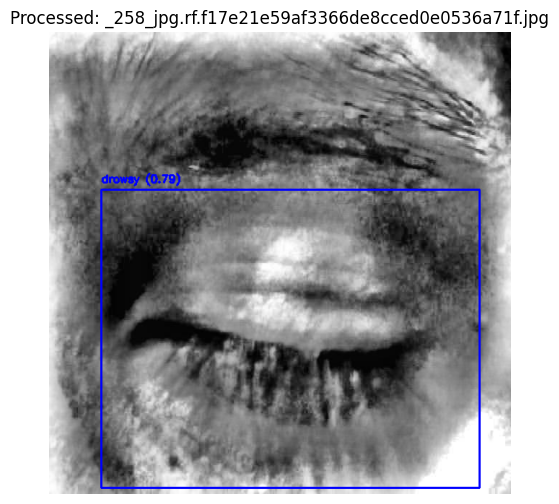


image 1/1 /content/dataset/test/images/2009_jpg.rf.e9f3e8296b24124f0ed483ae75a224f1.jpg: 416x416 1 not_drowsy, 15.3ms
Speed: 2.3ms preprocess, 15.3ms inference, 1.8ms postprocess per image at shape (1, 3, 416, 416)


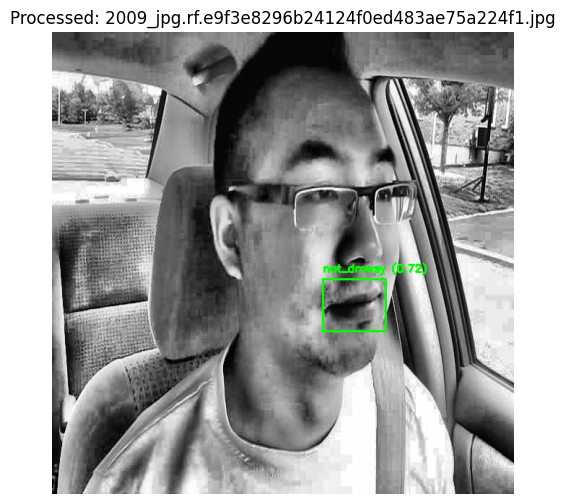


image 1/1 /content/dataset/test/images/2581_jpg.rf.8b14a051f3a003071d550d2ff2355f13.jpg: 416x416 1 not_drowsy, 10.9ms
Speed: 2.4ms preprocess, 10.9ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 416)


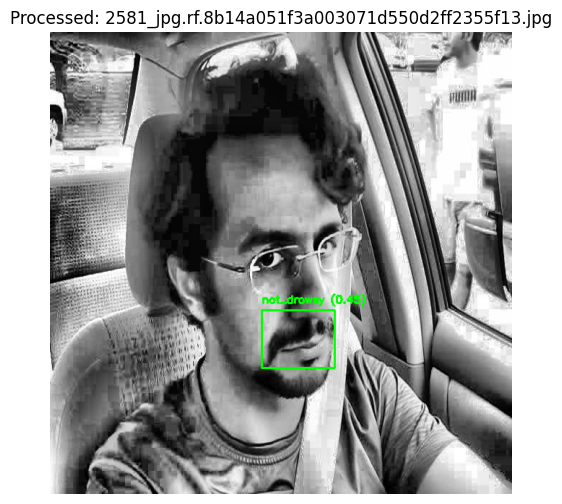


image 1/1 /content/dataset/test/images/602_jpg.rf.ce2c77cb2f72007defd7ca0a2a53bf7a.jpg: 416x416 1 drowsy, 15.8ms
Speed: 6.5ms preprocess, 15.8ms inference, 1.9ms postprocess per image at shape (1, 3, 416, 416)


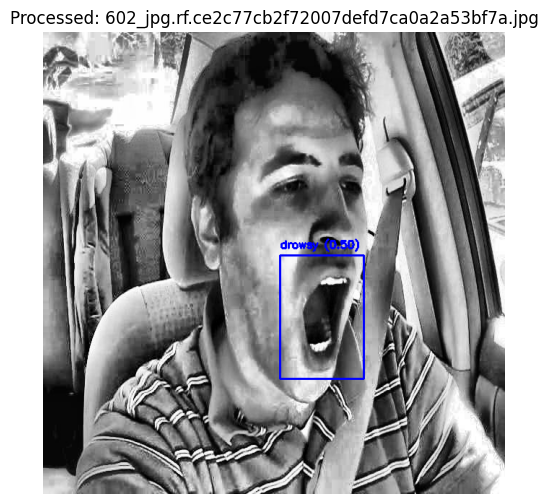


image 1/1 /content/dataset/test/images/141_jpg.rf.629a672debe893492d5d530d1e0cce39.jpg: 416x416 1 drowsy, 18.0ms
Speed: 2.4ms preprocess, 18.0ms inference, 1.9ms postprocess per image at shape (1, 3, 416, 416)


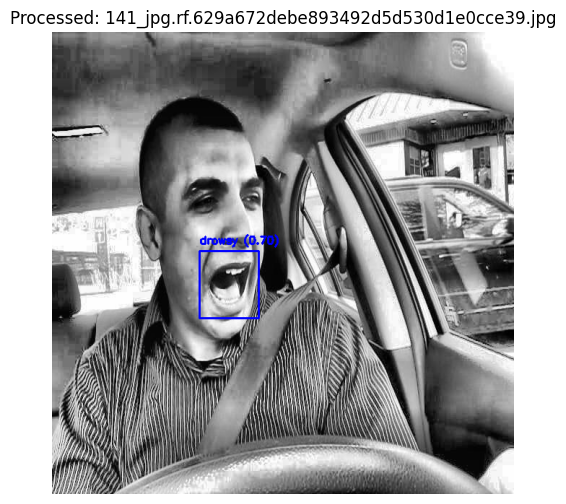


image 1/1 /content/dataset/test/images/_512_jpg.rf.1706da5b70e9f6e9ca3c9ad0aa1070fc.jpg: 416x416 1 drowsy, 18.4ms
Speed: 2.4ms preprocess, 18.4ms inference, 2.1ms postprocess per image at shape (1, 3, 416, 416)


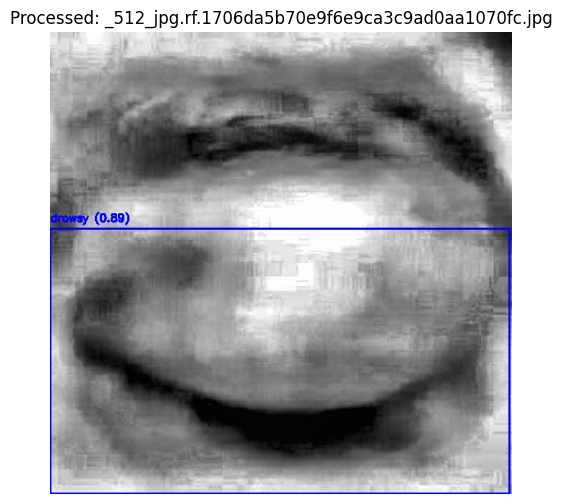


image 1/1 /content/dataset/test/images/591_jpg.rf.b28076f04400798007fc37c40f5f05ca.jpg: 416x416 1 drowsy, 13.6ms
Speed: 2.5ms preprocess, 13.6ms inference, 3.9ms postprocess per image at shape (1, 3, 416, 416)


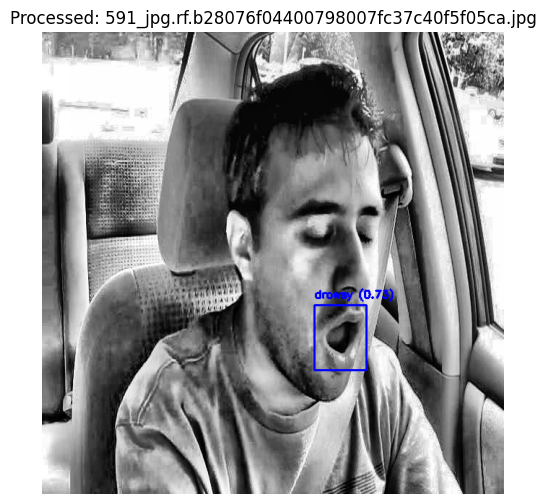


image 1/1 /content/dataset/test/images/2463_jpg.rf.f6952036d46e392e4b12cb3aae1ceb5b.jpg: 416x416 1 not_drowsy, 11.9ms
Speed: 2.2ms preprocess, 11.9ms inference, 1.8ms postprocess per image at shape (1, 3, 416, 416)


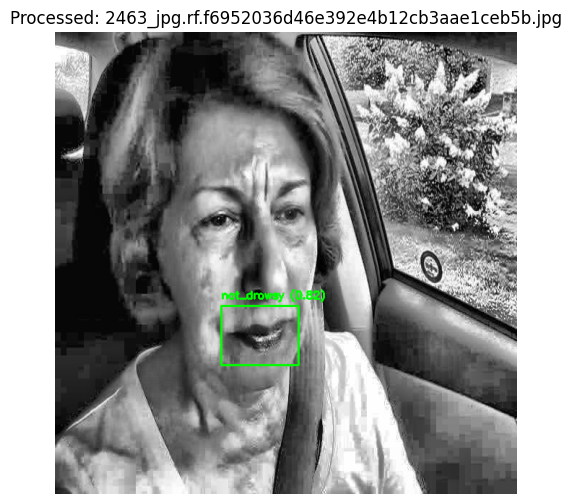


image 1/1 /content/dataset/test/images/_110_jpg.rf.9455e8ecf89e0b2512c02da898ebf271.jpg: 416x416 1 not_drowsy, 12.9ms
Speed: 2.5ms preprocess, 12.9ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 416)


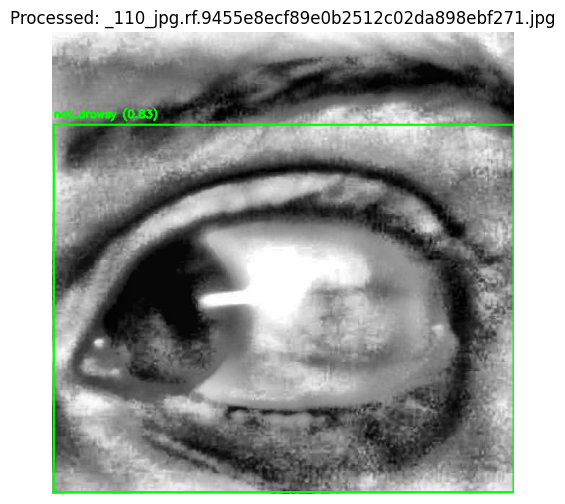


image 1/1 /content/dataset/test/images/_101_jpg.rf.093f4417ee0d5fdbb89e93a442999868.jpg: 416x416 1 not_drowsy, 18.0ms
Speed: 2.5ms preprocess, 18.0ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 416)


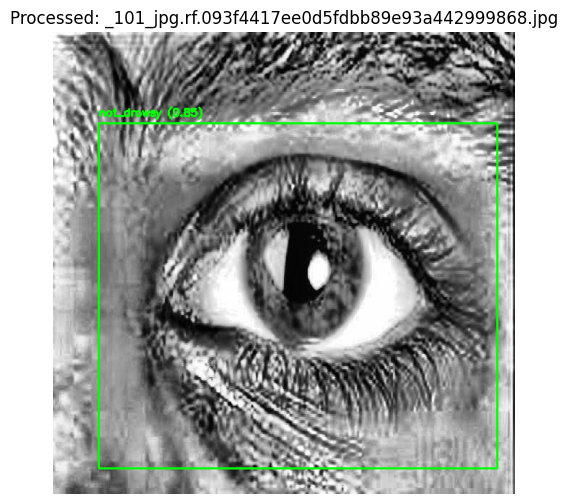


image 1/1 /content/dataset/test/images/_355_jpg.rf.6693175a9fc6f27556cec0f17c1b5298.jpg: 416x416 1 not_drowsy, 14.8ms
Speed: 7.4ms preprocess, 14.8ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 416)


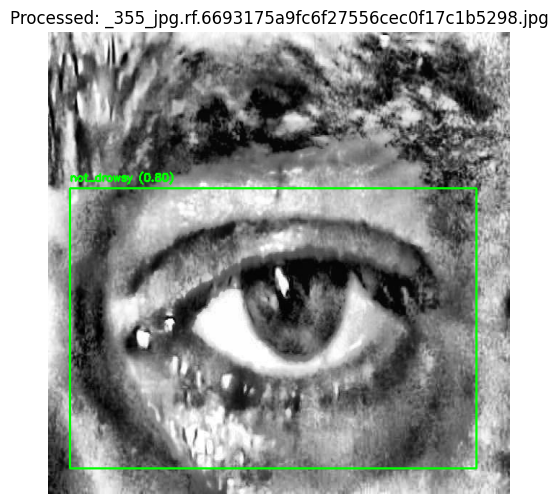


image 1/1 /content/dataset/test/images/2622_jpg.rf.084cdcc009d5339dbb3768ec19eca1cd.jpg: 416x416 1 not_drowsy, 14.6ms
Speed: 2.7ms preprocess, 14.6ms inference, 1.8ms postprocess per image at shape (1, 3, 416, 416)


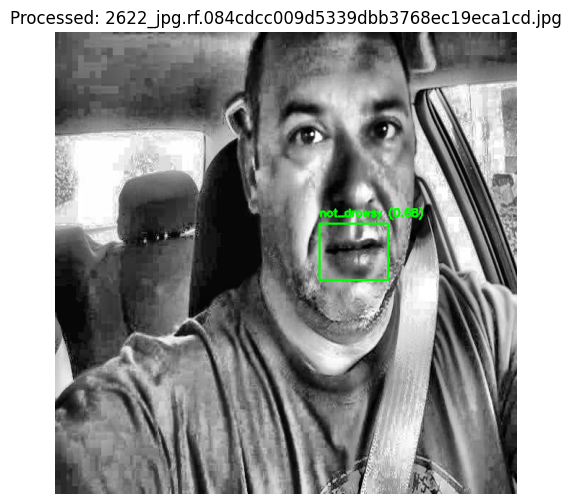


image 1/1 /content/dataset/test/images/440_jpg.rf.0b3837a82e329e4f1f6528ea8f916c07.jpg: 416x416 1 drowsy, 15.0ms
Speed: 6.7ms preprocess, 15.0ms inference, 2.6ms postprocess per image at shape (1, 3, 416, 416)


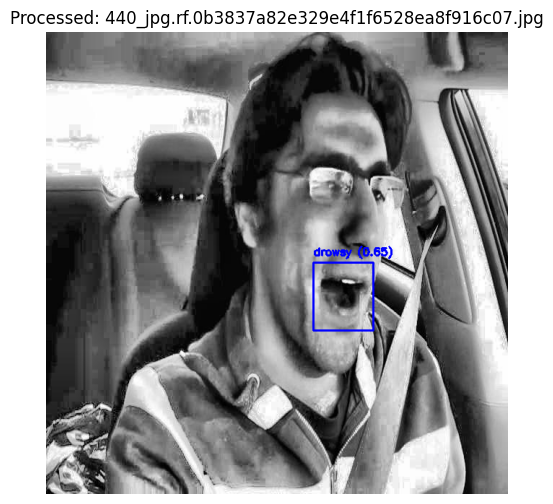


image 1/1 /content/dataset/test/images/219_jpg.rf.42cbd9987db5ac9fb4f1d40c522f1f3d.jpg: 416x416 1 drowsy, 12.5ms
Speed: 2.6ms preprocess, 12.5ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 416)


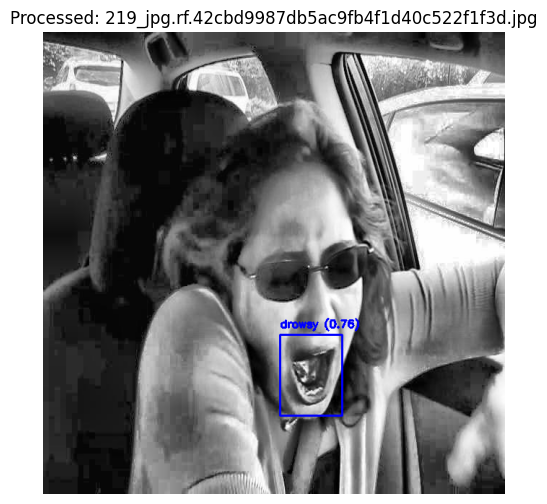


image 1/1 /content/dataset/test/images/758_jpg.rf.d76be9863290e040d3bd51cbc76188b3.jpg: 416x416 1 not_drowsy, 16.5ms
Speed: 4.4ms preprocess, 16.5ms inference, 1.9ms postprocess per image at shape (1, 3, 416, 416)


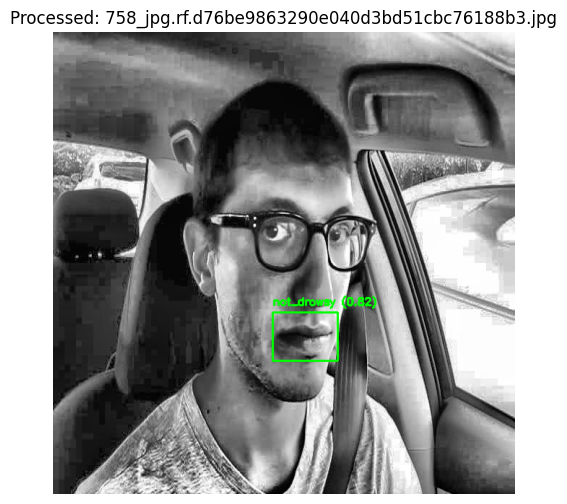


image 1/1 /content/dataset/test/images/1856_jpg.rf.698fd2da692819698d62e8ff7426aefa.jpg: 416x416 1 not_drowsy, 18.9ms
Speed: 2.5ms preprocess, 18.9ms inference, 3.3ms postprocess per image at shape (1, 3, 416, 416)


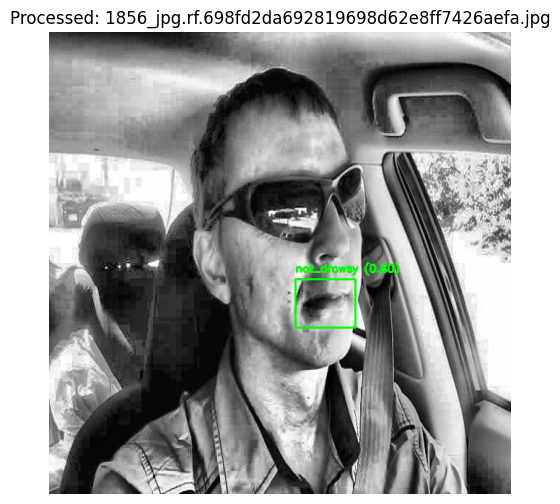


image 1/1 /content/dataset/test/images/_1_jpg.rf.f2c1acfde27ae6c73c0c28aab2efff1b.jpg: 416x416 1 not_drowsy, 9.8ms
Speed: 4.7ms preprocess, 9.8ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 416)


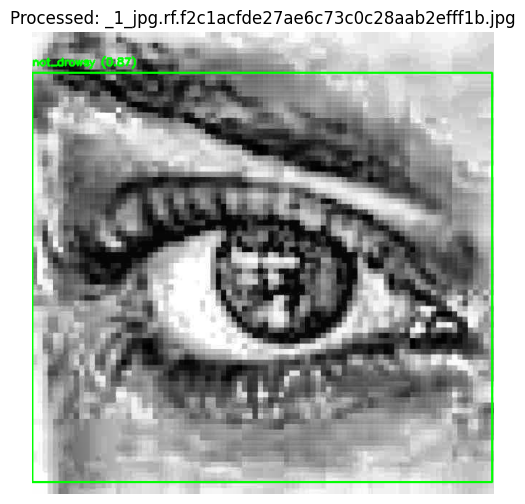


image 1/1 /content/dataset/test/images/_715_jpg.rf.d5b81dbe4b79fd796850e092c172627b.jpg: 416x416 1 not_drowsy, 12.5ms
Speed: 2.6ms preprocess, 12.5ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 416)


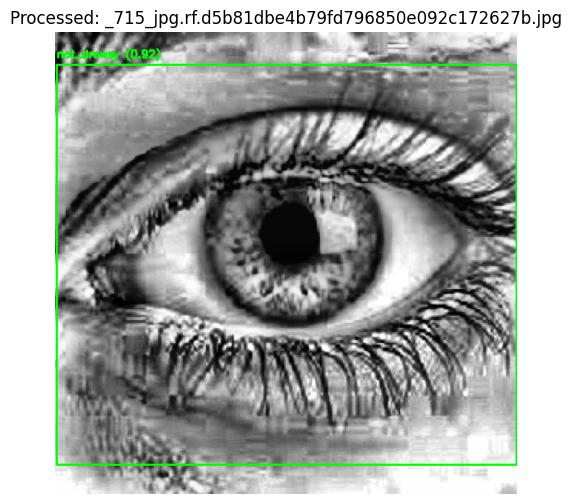


image 1/1 /content/dataset/test/images/576_jpg.rf.04d0df3d42a91728995e3efe6a4b9010.jpg: 416x416 1 drowsy, 9.9ms
Speed: 2.3ms preprocess, 9.9ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 416)


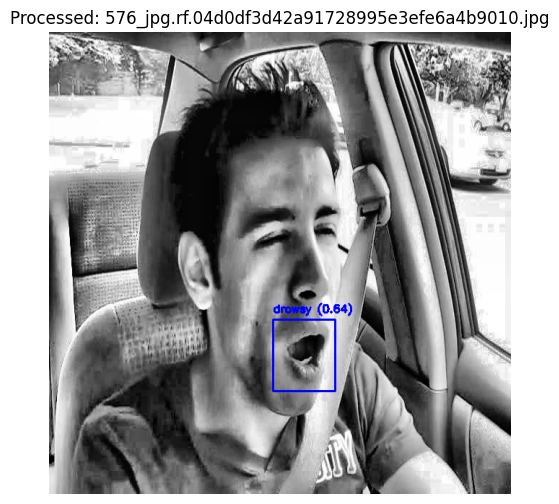


image 1/1 /content/dataset/test/images/_620_jpg.rf.e1d3c68d624913561a745f914b2de5de.jpg: 416x416 1 not_drowsy, 11.2ms
Speed: 2.6ms preprocess, 11.2ms inference, 2.9ms postprocess per image at shape (1, 3, 416, 416)


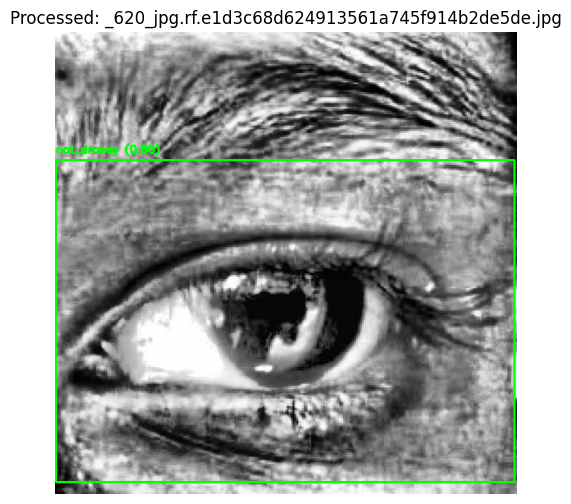


image 1/1 /content/dataset/test/images/_679_jpg.rf.f9cb844d3edc529f73f0206f852f50c7.jpg: 416x416 1 drowsy, 9.5ms
Speed: 5.5ms preprocess, 9.5ms inference, 4.1ms postprocess per image at shape (1, 3, 416, 416)


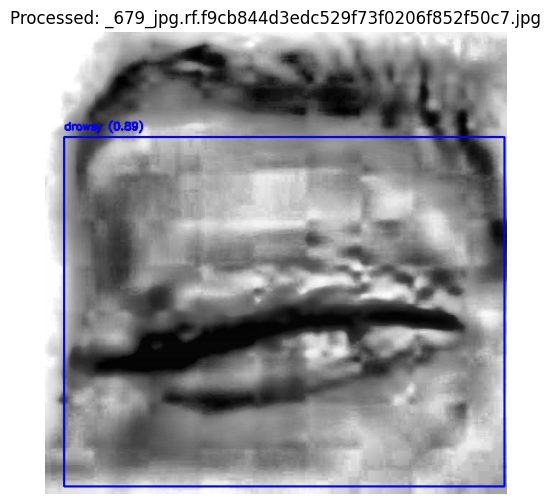


image 1/1 /content/dataset/test/images/_80_jpg.rf.02a4e5b3b03e8a06e487786dcd0fba12.jpg: 416x416 1 not_drowsy, 13.5ms
Speed: 2.5ms preprocess, 13.5ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 416)


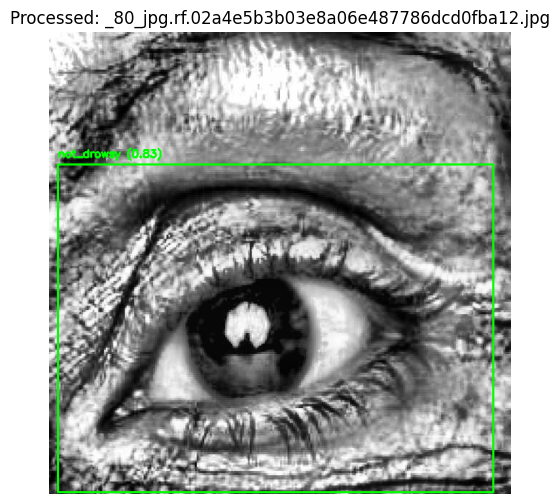


image 1/1 /content/dataset/test/images/2201_jpg.rf.5c817c0b653d7a01ea91d8797a543989.jpg: 416x416 1 not_drowsy, 9.7ms
Speed: 6.6ms preprocess, 9.7ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 416)


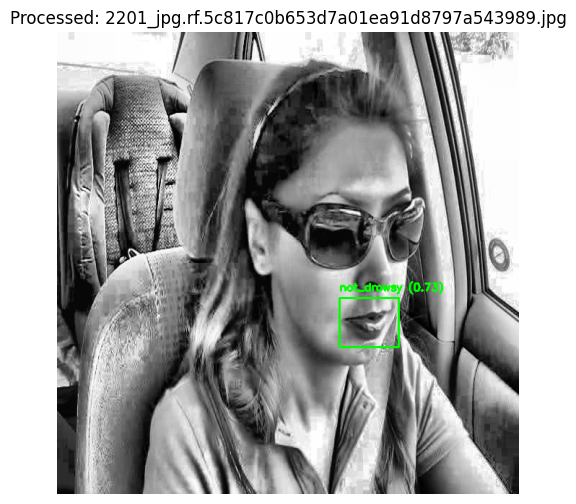


image 1/1 /content/dataset/test/images/_397_jpg.rf.a0f45454c216f2a4c977ee50854b8812.jpg: 416x416 1 not_drowsy, 10.4ms
Speed: 5.4ms preprocess, 10.4ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 416)


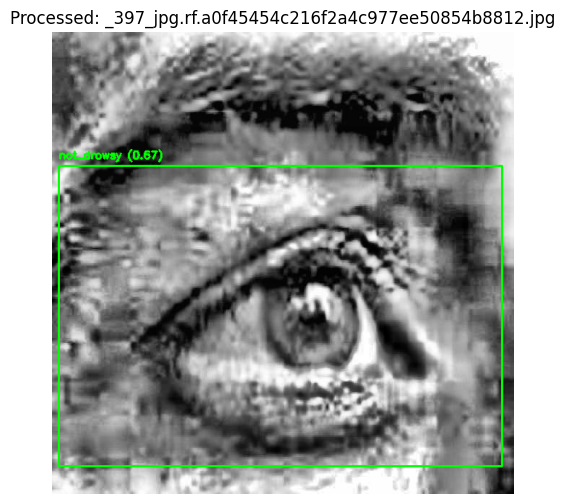


image 1/1 /content/dataset/test/images/_126_jpg.rf.228abe1286289c25de0b6b3121ecd078.jpg: 416x416 1 drowsy, 12.9ms
Speed: 2.3ms preprocess, 12.9ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 416)


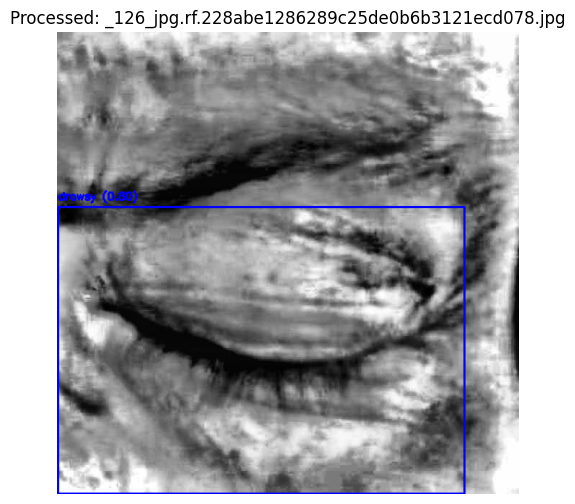


image 1/1 /content/dataset/test/images/1913_jpg.rf.b27667b454d9be657cacea69402abf72.jpg: 416x416 1 not_drowsy, 11.5ms
Speed: 4.8ms preprocess, 11.5ms inference, 2.3ms postprocess per image at shape (1, 3, 416, 416)


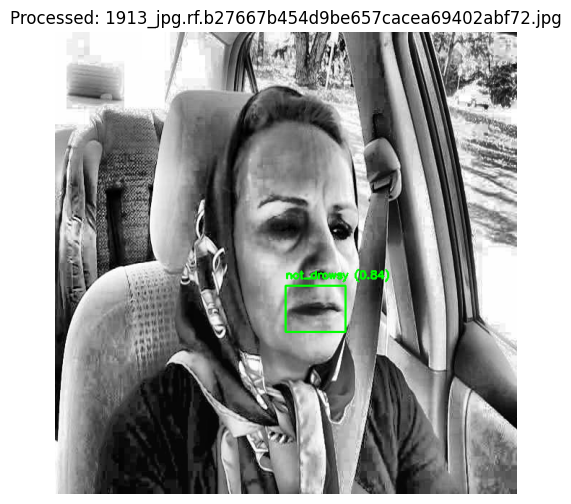


image 1/1 /content/dataset/test/images/497_jpg.rf.f41c6592ee93d46f4252e73fcd13b42a.jpg: 416x416 3 drowsys, 1 not_drowsy, 18.6ms
Speed: 2.5ms preprocess, 18.6ms inference, 2.0ms postprocess per image at shape (1, 3, 416, 416)


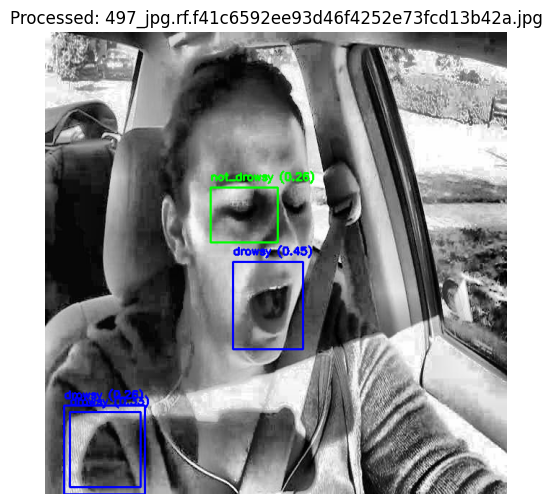


image 1/1 /content/dataset/test/images/_283_jpg.rf.73df50fb1e72ae35fe66e824d23a1f6e.jpg: 416x416 1 not_drowsy, 13.3ms
Speed: 7.4ms preprocess, 13.3ms inference, 2.2ms postprocess per image at shape (1, 3, 416, 416)


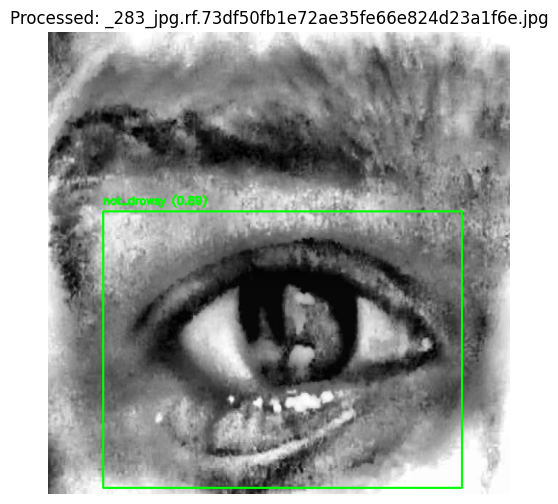


image 1/1 /content/dataset/test/images/2288_jpg.rf.33b508db49c876ffbf431866e7d94357.jpg: 416x416 1 not_drowsy, 12.1ms
Speed: 7.7ms preprocess, 12.1ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 416)


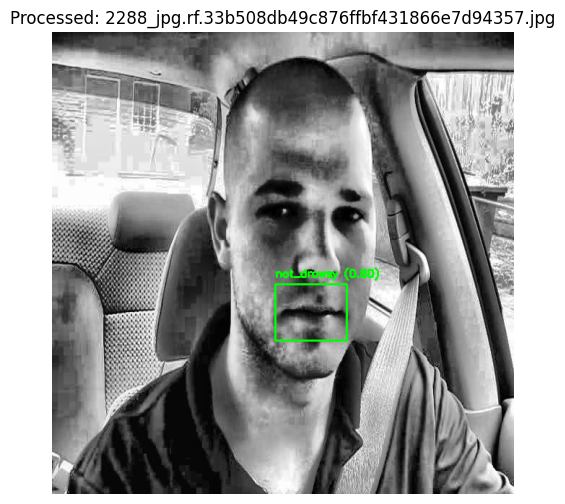


image 1/1 /content/dataset/test/images/420_jpg.rf.b5ef221e847dc502d5ade8f4bb7ad0a9.jpg: 416x416 1 not_drowsy, 10.2ms
Speed: 2.5ms preprocess, 10.2ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 416)


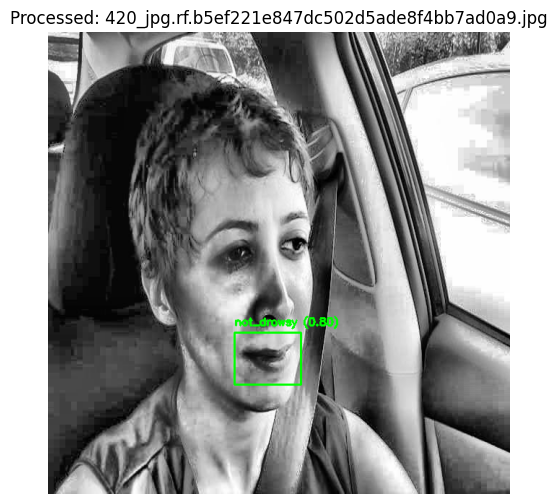


image 1/1 /content/dataset/test/images/1097_jpg.rf.cbc6711106d7cc79fff23d569bb2032f.jpg: 416x416 1 not_drowsy, 9.9ms
Speed: 3.4ms preprocess, 9.9ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 416)


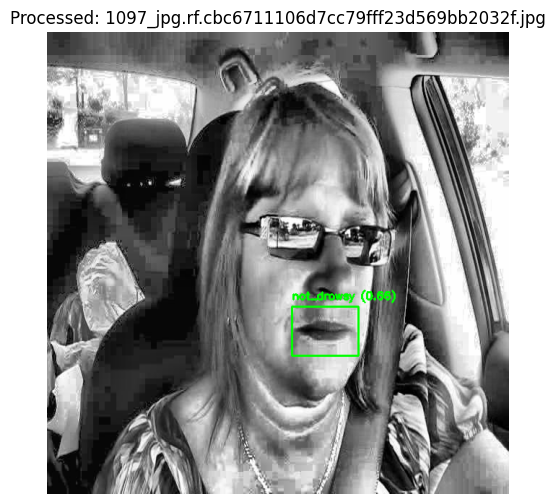


image 1/1 /content/dataset/test/images/716_jpg.rf.a8006d2e2a13f78086bab4ad0f17a8ca.jpg: 416x416 2 drowsys, 10.3ms
Speed: 2.5ms preprocess, 10.3ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 416)


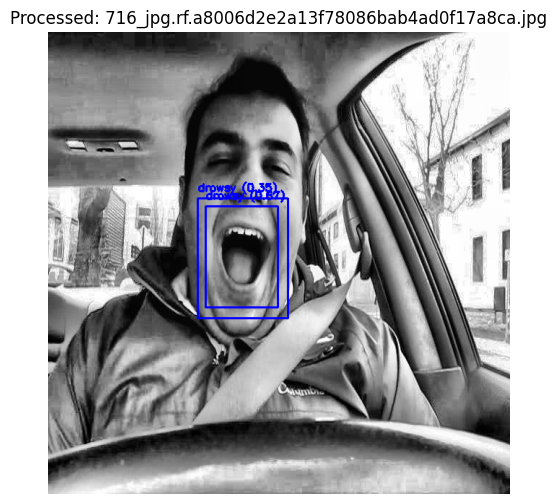


image 1/1 /content/dataset/test/images/_388_jpg.rf.01f7e19bbb4c11ae94e07c4de38cfa70.jpg: 416x416 1 drowsy, 9.7ms
Speed: 2.5ms preprocess, 9.7ms inference, 4.6ms postprocess per image at shape (1, 3, 416, 416)


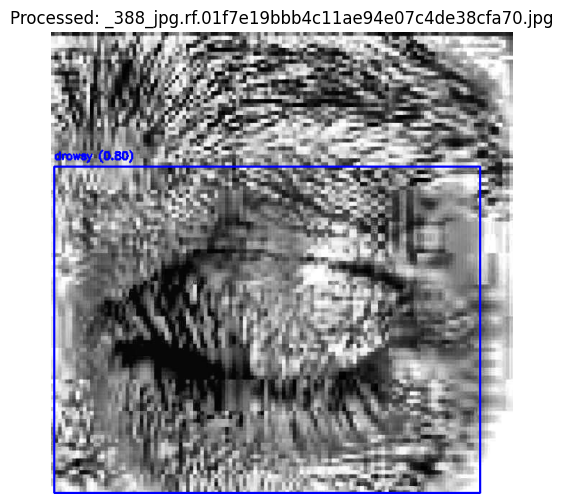


image 1/1 /content/dataset/test/images/_414_jpg.rf.8973f2a529a088811ef6215f76abc886.jpg: 416x416 1 drowsy, 11.2ms
Speed: 2.4ms preprocess, 11.2ms inference, 3.7ms postprocess per image at shape (1, 3, 416, 416)


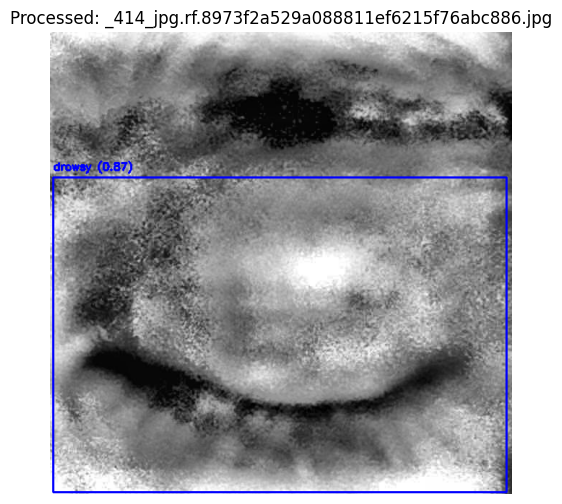


image 1/1 /content/dataset/test/images/_586_jpg.rf.4501b42682f32dfebeea5c1e991401db.jpg: 416x416 1 not_drowsy, 16.5ms
Speed: 2.4ms preprocess, 16.5ms inference, 1.8ms postprocess per image at shape (1, 3, 416, 416)


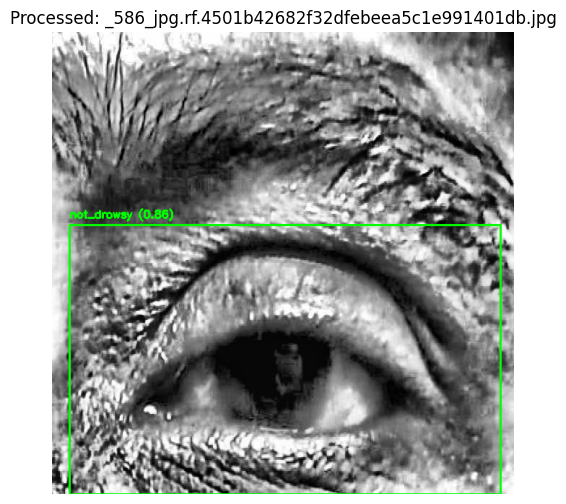


image 1/1 /content/dataset/test/images/_551_jpg.rf.280dac3202c07a23fd34bee96243edbc.jpg: 416x416 1 not_drowsy, 15.3ms
Speed: 2.4ms preprocess, 15.3ms inference, 2.3ms postprocess per image at shape (1, 3, 416, 416)


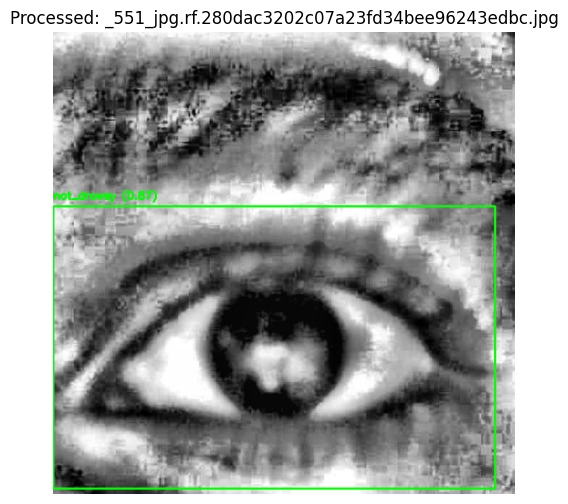


image 1/1 /content/dataset/test/images/_721_jpg.rf.0a3b1032ad59517b06570355f8ac7764.jpg: 416x416 1 not_drowsy, 9.6ms
Speed: 2.4ms preprocess, 9.6ms inference, 1.7ms postprocess per image at shape (1, 3, 416, 416)


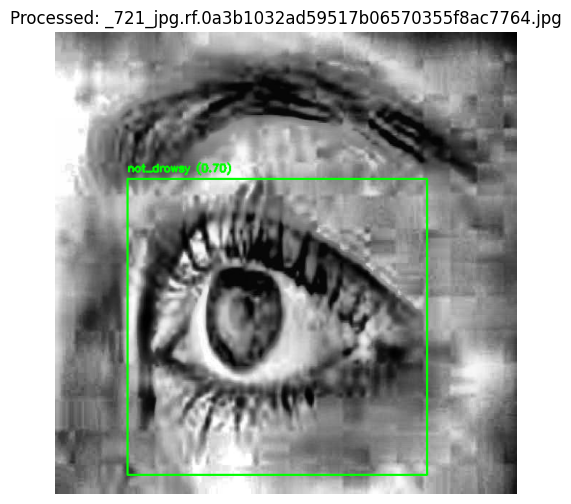

In [ ]:
import cv2
import os
import random
import torch
import numpy as np
import matplotlib.pyplot as plt
from ultralytics import YOLO
from PIL import Image

# Load trained YOLOv8 model
yolo_model = YOLO("/content/runs/detect/train/weights/best.pt")  # Change to your trained YOLO model path

# Path to test dataset images
test_images_dir = "/content/dataset/test/images"  # Change path if needed

# Get a list of all test images
all_images = [os.path.join(test_images_dir, img) for img in os.listdir(test_images_dir) if img.endswith(".jpg")]

# Select 50 random images for testing
random_images = random.sample(all_images, min(50, len(all_images)))

# Function to process and test on one image
def test_image(image_path):
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Run YOLOv8 inference
    results = yolo_model(image_path)

    # Draw bounding boxes on the image
    for result in results:
        for box in result.boxes:
            x1, y1, x2, y2 = map(int, box.xyxy[0])
            conf = box.conf[0].item()
            label = result.names[int(box.cls[0].item())]

            # Choose color based on label
            color = (0, 255, 0) if label == "not_drowsy" else (0, 0, 255)

            # Draw bounding box and label
            cv2.rectangle(image_rgb, (x1, y1), (x2, y2), color, 2)
            cv2.putText(image_rgb, f"{label} ({conf:.2f})", (x1, y1 - 10),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

    return image_rgb

# Process & display 50 images
for img_path in random_images:
    processed_image = test_image(img_path)

    plt.figure(figsize=(6, 6))
    plt.imshow(processed_image)
    plt.axis("off")
    plt.title(f"Processed: {os.path.basename(img_path)}")
    plt.show()
